# Liquid Noise

## Licensing

In [1]:
from importlib import reload
from functools import partial
from typing import Optional, Union, Tuple, List, Callable, Dict
import torch
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, DDIMScheduler
import torch.nn.functional as nnf
from scipy import interpolate
from PIL import Image, ImageFilter
import numpy as np
import cv2
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from IPython.display import clear_output
from torch.optim.adam import Adam
import abc
import ptp_utils_new as ptp_utils
import seq_aligner
reload(ptp_utils)
reload(seq_aligner)

<module 'seq_aligner' from 'c:\\Users\\mhaar\\Documents\\Docs\\FYP\\liquidnoise\\seq_aligner.py'>

For loading the Stable Diffusion using Diffusers, follow the instuctions https://huggingface.co/blog/stable_diffusion and update ```MY_TOKEN``` with your token.
Set ```LOW_RESOURCE``` to ```True``` for running on 12GB GPU.

In [2]:
torch.cuda.empty_cache()
device = torch.device('cuda:0')
controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-seg")
ldm_stable = StableDiffusionControlNetPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", use_safetensors=True, controlnet=controlnet)
ldm_stable.scheduler = DDIMScheduler(
    beta_start=0.00085,
    beta_end=0.012,
    beta_schedule="scaled_linear",
    steps_offset=1,
    clip_sample=False)
ldm_stable.to(device)
tokenizer = ldm_stable.tokenizer

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [3]:
torch.cuda.empty_cache()
LOW_RESOURCE = True
NUM_DIFFUSION_STEPS = 20
GUIDANCE_SCALE = 8.0
MAX_NUM_WORDS = 77
ldm_stable.cond_scale = 1.0
seed = 1
roll_frac = 8
roll_noise = True
roll_attention = False
roll_control = True

## Prompt-to-Prompt Attention Controllers
Our main logic is implemented in the `forward` call in an `AttentionControl` object.
The forward is called in each attention layer of the diffusion model and it can modify the input attnetion weights `attn`.

`is_cross`, `place_in_unet in ("down", "mid", "up")`, `AttentionControl.cur_step` help us track the exact attention layer and timestamp during the diffusion iference.


In [4]:
class LocalBlend:

    def __call__(self, x_t, attention_store):
        k = 1
        maps = attention_store["down_cross"][2:4] + attention_store["up_cross"][:3]
        maps = [item.reshape(self.alpha_layers.shape[0], -1, 1, 16, 16, MAX_NUM_WORDS) for item in maps]
        maps = torch.cat(maps, dim=1)
        maps = (maps * self.alpha_layers).sum(-1).mean(1)
        mask = nnf.max_pool2d(maps, (k * 2 + 1, k * 2 +1), (1, 1), padding=(k, k))
        mask = nnf.interpolate(mask, size=(x_t.shape[2:]))
        mask = mask / mask.max(2, keepdims=True)[0].max(3, keepdims=True)[0]
        mask = mask.gt(self.threshold)
        mask = (mask[:1] + mask[1:]).float()
        x_t = x_t[:1] + mask * (x_t - x_t[:1])
        return x_t
       
    def __init__(self, prompts: List[str], words: [List[List[str]]], threshold=.3):
        alpha_layers = torch.zeros(len(prompts),  1, 1, 1, 1, MAX_NUM_WORDS)
        for i, (prompt, words_) in enumerate(zip(prompts, words)):
            if type(words_) is str:
                words_ = [words_]
            for word in words_:
                ind = ptp_utils.get_word_inds(prompt, word, tokenizer)
                alpha_layers[i, :, :, :, :, ind] = 1
        self.alpha_layers = alpha_layers.to(device)
        self.threshold = threshold


class AttentionControl(abc.ABC):
    
    def step_callback(self, x_t):
        return x_t
    
    def between_steps(self):
        return
    
    @property
    def num_uncond_att_layers(self):
        return self.num_att_layers if LOW_RESOURCE else 0
    
    @abc.abstractmethod
    def forward (self, attn, is_cross: bool, place_in_unet: str):
        raise NotImplementedError

    def __call__(self, attn, is_cross: bool, place_in_unet: str):
        if self.cur_att_layer >= self.num_uncond_att_layers:
            if LOW_RESOURCE:
                attn = self.forward(attn, is_cross, place_in_unet)
            else:
                h = attn.shape[0]
                attn[h // 2:] = self.forward(attn[h // 2:], is_cross, place_in_unet)
        self.cur_att_layer += 1
        if self.cur_att_layer == self.num_att_layers + self.num_uncond_att_layers:
            self.cur_att_layer = 0
            self.cur_step += 1
            self.between_steps()
        return attn
    
    def reset(self):
        self.cur_step = 0
        self.cur_att_layer = 0

    def __init__(self):
        self.cur_step = 0
        self.num_att_layers = -1
        self.cur_att_layer = 0

class EmptyControl(AttentionControl):
    
    def forward (self, attn, is_cross: bool, place_in_unet: str):
        return attn
    
    
class AttentionStore(AttentionControl):

    @staticmethod
    def get_empty_store():
        return {"down_cross": [], "mid_cross": [], "up_cross": [],
                "down_self": [],  "mid_self": [],  "up_self": []}

    def forward(self, attn, is_cross: bool, place_in_unet: str):
        key = f"{place_in_unet}_{'cross' if is_cross else 'self'}"
        if attn.shape[1] <= 32 ** 2:  # avoid memory overhead
            self.step_store[key].append(attn)
        return attn

    def between_steps(self):
        self.last_step_store = self.step_store.copy()
        if len(self.attention_store) == 0:
            self.attention_store = self.step_store
        else:
            for key in self.attention_store:
                for i in range(len(self.attention_store[key])):
                    self.attention_store[key][i] += self.step_store[key][i]
        self.step_store = self.get_empty_store()

    def get_average_attention(self):
        average_attention = {key: [item / self.cur_step for item in self.attention_store[key]] for key in self.attention_store}
        return average_attention
    
    def get_last_attention(self):
        last_attention = {key: [item for item in self.last_step_store[key]] for key in self.last_step_store}
        return last_attention

    def reset(self):
        super(AttentionStore, self).reset()
        self.step_store = self.get_empty_store()
        self.attention_store = {}

    def __init__(self):
        super(AttentionStore, self).__init__()
        self.step_store = self.get_empty_store()
        self.attention_store = {}

        
class AttentionControlEdit(AttentionStore, abc.ABC):
    
    def step_callback(self, x_t):
        if self.local_blend is not None:
            x_t = self.local_blend(x_t, self.attention_store)
        return x_t
        
    def replace_self_attention(self, attn_base, att_replace):
        if att_replace.shape[2] <= 16 ** 2:
            return attn_base.unsqueeze(0).expand(att_replace.shape[0], *attn_base.shape)
        else:
            return att_replace
    
    @abc.abstractmethod
    def replace_cross_attention(self, attn_base, att_replace):
        raise NotImplementedError
    
    def forward(self, attn, is_cross: bool, place_in_unet: str):
        super(AttentionControlEdit, self).forward(attn, is_cross, place_in_unet)
        if is_cross or (self.num_self_replace[0] <= self.cur_step < self.num_self_replace[1]):
            h = attn.shape[0] // (self.batch_size)
            attn = attn.reshape(self.batch_size, h, *attn.shape[1:])
            attn_base, attn_repalce = attn[0], attn[1:]
            if is_cross:
                alpha_words = self.cross_replace_alpha[self.cur_step]
                attn_repalce_new = self.replace_cross_attention(attn_base, attn_repalce) * alpha_words + (1 - alpha_words) * attn_repalce
                attn[1:] = attn_repalce_new
            else:
                attn[1:] = self.replace_self_attention(attn_base, attn_repalce)
            attn = attn.reshape(self.batch_size * h, *attn.shape[2:])
        return attn
    
    def __init__(self, prompts, num_steps: int,
                 cross_replace_steps: Union[float, Tuple[float, float], Dict[str, Tuple[float, float]]],
                 self_replace_steps: Union[float, Tuple[float, float]],
                 local_blend: Optional[LocalBlend]):
        super(AttentionControlEdit, self).__init__()
        self.batch_size = len(prompts)
        self.cross_replace_alpha = ptp_utils.get_time_words_attention_alpha(prompts, num_steps, cross_replace_steps, tokenizer).to(device)
        if type(self_replace_steps) is float:
            self_replace_steps = 0, self_replace_steps
        self.num_self_replace = int(num_steps * self_replace_steps[0]), int(num_steps * self_replace_steps[1])
        self.local_blend = local_blend

class AttentionReplace(AttentionControlEdit):

    def replace_cross_attention(self, attn_base, att_replace):
        return torch.einsum('hpw,bwn->bhpn', attn_base, self.mapper)
      
    def __init__(self, prompts, num_steps: int, cross_replace_steps: float, self_replace_steps: float,
                 local_blend: Optional[LocalBlend] = None):
        super(AttentionReplace, self).__init__(prompts, num_steps, cross_replace_steps, self_replace_steps, local_blend)
        self.mapper = seq_aligner.get_replacement_mapper(prompts, tokenizer).to(device)

class AttentionPermute(AttentionControlEdit):

    def replace_cross_attention(self, attn_base, att_replace):
        if self.cur_step > 0.25*NUM_DIFFUSION_STEPS:
            res = int(np.sqrt(attn_base.shape[1]))
            num_pixels = res ** 2
            frac = res/roll_frac
            cross_map = attn_base.reshape(len(prompts), -1, res, res, attn_base.shape[-1])[0]
            if res >= roll_frac:
                for i in range(res):
                    cross_map[:, :, i, :] = cross_map[:, :, (i+int(frac))%res, :]
            else:
                for i in range(res):
                    cross_map[:, :, i, :] = (1-frac)*cross_map[:, :, i, :] + frac*cross_map[:, :, (i+1)%res, :]
            permuted_attn = cross_map.reshape(attn_base.shape[0], num_pixels, attn_base.shape[-1])
            return permuted_attn
        else:
            return attn_base


      
    def __init__(self, prompts, num_steps: int, cross_replace_steps: float, self_replace_steps: float,
                 local_blend: Optional[LocalBlend] = None):
        super(AttentionPermute, self).__init__(prompts, num_steps, cross_replace_steps, self_replace_steps, local_blend)
        

class AttentionRefine(AttentionControlEdit):

    def replace_cross_attention(self, attn_base, att_replace):
        attn_base_replace = attn_base[:, :, self.mapper].permute(2, 0, 1, 3)
        attn_replace = attn_base_replace * self.alphas + att_replace * (1 - self.alphas)
        return attn_replace

    def __init__(self, prompts, num_steps: int, cross_replace_steps: float, self_replace_steps: float,
                 local_blend: Optional[LocalBlend] = None):
        super(AttentionRefine, self).__init__(prompts, num_steps, cross_replace_steps, self_replace_steps, local_blend)
        self.mapper, alphas = seq_aligner.get_refinement_mapper(prompts, tokenizer)
        self.mapper, alphas = self.mapper.to(device), alphas.to(device)
        self.alphas = alphas.reshape(alphas.shape[0], 1, 1, alphas.shape[1])


class AttentionReweight(AttentionControlEdit):

    def replace_cross_attention(self, attn_base, att_replace):
        if self.prev_controller is not None:
            attn_base = self.prev_controller.replace_cross_attention(attn_base, att_replace)
        attn_replace = attn_base[None, :, :, :] * self.equalizer[:, None, None, :]
        return attn_replace

    def __init__(self, prompts, num_steps: int, cross_replace_steps: float, self_replace_steps: float, equalizer,
                local_blend: Optional[LocalBlend] = None, controller: Optional[AttentionControlEdit] = None):
        super(AttentionReweight, self).__init__(prompts, num_steps, cross_replace_steps, self_replace_steps, local_blend)
        self.equalizer = equalizer.to(device)
        self.prev_controller = controller


def get_equalizer(text: str, word_select: Union[int, Tuple[int, ...]], values: Union[List[float],
                  Tuple[float, ...]]):
    if type(word_select) is int or type(word_select) is str:
        word_select = (word_select,)
    equalizer = torch.ones(len(values), 77)
    values = torch.tensor(values, dtype=torch.float32)
    for word in word_select:
        inds = ptp_utils.get_word_inds(text, word, tokenizer)
        equalizer[:, inds] = values
    return equalizer


In [5]:
def aggregate_attention(attention_store: AttentionStore, res: int, from_where: List[str], is_cross: bool, select: int, last):
    out = []
    if last:
        attention_maps = attention_store.get_last_attention()
    else:
        attention_maps = attention_store.get_average_attention()
    num_pixels = res ** 2
    for location in from_where:
        for item in attention_maps[f"{location}_{'cross' if is_cross else 'self'}"]:
            if item.shape[1] == num_pixels:
                cross_maps = item.reshape(len(prompts), -1, res, res, item.shape[-1])[select]
                out.append(cross_maps)
    out = torch.cat(out, dim=0)
    out = out.sum(0) / out.shape[0]
    return out.cpu()


def show_cross_attention(attention_store: AttentionStore, res: int, from_where: List[str], last=False, select: int = 0):
    tokens = tokenizer.encode(prompts[select])
    decoder = tokenizer.decode
    attention_maps = aggregate_attention(attention_store, res, from_where, True, select, last)
    images = []
    for i in range(len(tokens)):
        image = attention_maps[:, :, i]
        image = 255 * image / image.max()
        image = image.unsqueeze(-1).expand(*image.shape, 3)
        image = image.numpy().astype(np.uint8)
        image = np.array(Image.fromarray(image).resize((256, 256), Image.NEAREST))
        image = ptp_utils.text_under_image(image, decoder(int(tokens[i])))
        images.append(image)
    ptp_utils.view_images(np.stack(images, axis=0))
    
def show_self_attention_comp(attention_store: AttentionStore, res: int, from_where: List[str],
                        max_com=10, select: int = 0):
    attention_maps = aggregate_attention(attention_store, res, from_where, False, select, False).numpy().reshape((res ** 2, res ** 2))
    u, s, vh = np.linalg.svd(attention_maps - np.mean(attention_maps, axis=1, keepdims=True))
    images = []
    for i in range(max_com):
        image = vh[i].reshape(res, res)
        image = image - image.min()
        image = 255 * image / image.max()
        image = np.repeat(np.expand_dims(image, axis=2), 3, axis=2).astype(np.uint8)
        image = Image.fromarray(image).resize((256, 256), Image.NEAREST)
        image = np.array(image)
        images.append(image)
    ptp_utils.view_images(np.concatenate(images, axis=1))

In [6]:
def run_and_display(prompts, controller, latent=None, control=None, run_baseline=False, seed=1):
    generator=torch.Generator().manual_seed(seed)
    if run_baseline:
        print("w.o. prompt-to-prompt")
        images, latent = run_and_display(prompts, EmptyControl(), latent=latent, control=control, run_baseline=False, seed=seed)
        print("with prompt-to-prompt")
    images, _, _, x_t = ptp_utils.text2image_ldm_stable(ldm_stable, prompts, controller, latent=latent, control=control, num_inference_steps=NUM_DIFFUSION_STEPS, guidance_scale=GUIDANCE_SCALE, generator=generator, low_resource=LOW_RESOURCE)
    ptp_utils.view_images(images)
    torch.cuda.empty_cache()
    return images, x_t

## Plotting and Latents

In [7]:
def view_noise(noise):
	noise2 = noise.detach().clone().cpu()
	noise2 = (noise2 / 4 + 0.5).clamp(0, 1)
	noise2 = noise2.cpu().permute(0, 2, 3, 1).numpy()
	noise2 = (noise2 * 255).astype(np.uint8)
	noise2 = Image.fromarray(noise2[0]).resize((256, 256), Image.NEAREST).convert('RGB')
	display(noise2)

def return_noise(noise, channel=None):
	noise2 = noise.detach().clone().cpu()
	noise2 = (noise2 / 4 + 0.5).clamp(0, 1)
	noise2 = noise2.cpu().permute(0, 2, 3, 1).numpy()
	noise2 = (noise2 * 255).astype(np.uint8)
	if channel is not None:
		for i in range(4):
			if i != channel:
				noise2[:, :, :, i] = noise2[:, :, :, channel]
	noise2 = Image.fromarray(noise2[0]).resize((256, 256), Image.NEAREST).convert('RGB')
	return noise2

def view_noise_channels(noise):
	noise2 = noise.detach().clone().cpu()
	noise2 = (noise2 / 4 + 0.5).clamp(0, 1)
	noise2 = noise2.cpu().permute(0, 2, 3, 1).numpy()
	noise2 = (noise2 * 255).astype(np.uint8)
	channels = np.concatenate([noise2[0, :, :, i] for i in range(4)], axis=1)
	channels = Image.fromarray(channels).resize((1024, 256), Image.NEAREST).convert('RGB')
	display(channels)

def latents_to_rgb(latents):
	weights = (
		(43.8964,  16.3552, -35.4404, -21.6123),
        (29.6584,  44.5785,  32.1088, -29.1559),
        (36.2716,   5.5332,  28.2693, -82.5393)
		)
	biases = (123.5403, 111.4831,  98.5240)
	weights_tensor = torch.t(torch.tensor(weights, dtype=latents.dtype).to(latents.device))
	biases_tensor = torch.tensor(biases, dtype=latents.dtype).to(latents.device)
	rgb_tensor = torch.einsum("...lxy,lr -> ...rxy", latents, weights_tensor) + biases_tensor.unsqueeze(-1).unsqueeze(-1)
	image_array = rgb_tensor.clamp(0, 255)[0].byte().cpu().numpy()
	image_array = image_array.transpose(1, 2, 0)
	return Image.fromarray(image_array).resize((256, 256), Image.NEAREST).convert('RGB')

def create_latent(prompt, seed=1):
	batch_size = len(prompt)
	generator=torch.Generator().manual_seed(seed)
	latent, _ = ptp_utils.init_latent(None, ldm_stable, 512, 512, generator, batch_size)
	return latent.detach().cuda()

def discrete_latent(prompts, seed=1):
	x_t = create_latent(prompts, seed=seed)
	x_t = 1/0.18215 * x_t
	with torch.no_grad():
		img = ldm_stable.vae.decode(x_t)['sample']
		x_t_2 = ldm_stable.vae.encode(img)['latent_dist'].mean.detach().cpu()
	x_t_2 = x_t_2 * 0.18215
	return x_t_2

def Img2noise(model, generator, switch_percent, image):
	noise = torch.randn((1,4,64,64), generator=generator).cuda()
	latent = ptp_utils.image2latent(ldm_stable.vae, np.array(image))
	timesteps = torch.LongTensor([int(NUM_DIFFUSION_STEPS*switch_percent/100)]).cuda()
	noisy_latent = model.scheduler.add_noise(latent, noise, timesteps)
	return noisy_latent

def show_histogram(x_t):
	if torch.is_tensor(x_t):
		x_t = x_t.cpu().numpy()
	plt.hist(x_t.flatten(), bins=100)
	plt.xlim(-4.5, 4.5)
	print("mean", x_t.flatten().mean())
	print("std", x_t.flatten().std())
	plt.show()

def q_q_plot(x_t):
	if torch.is_tensor(x_t):
		x_t = x_t.cpu().numpy()
	sorted_x_t = np.sort(x_t.flatten())
	gaussian_quantiles = sorted(np.random.normal(0, 1, x_t.size).flatten())
	plt.figure(figsize=(6, 6))
	plt.scatter(gaussian_quantiles, sorted_x_t, s=0.2)
	plt.xlabel('Theoretical Quantiles')
	plt.ylabel('Ordered Values')
	plt.ylim([-4.5,4.5])
	plt.xlim([-4.5,4.5])
	plt.title('Q-Q Plot')
	plt.grid(True)
	plt.show()

def DFT(x_t):
	if torch.is_tensor(x_t):
		x_t = x_t.cpu().numpy()
	x_t_ = x_t.flatten()
	fft = np.fft.fft(x_t_)
	n = len(fft)
	print(np.abs(fft)[0:5])
	freq = np.fft.fftfreq(n)
	plt.plot(freq[:n//2], np.abs(fft)[:n//2])
	plt.show()

def DFT_2D(x_t):
	if torch.is_tensor(x_t):
		x_t = x_t.cpu().numpy()
	x_t_ = x_t[0][0]
	fft = np.fft.fft2(x_t_)
	fft = np.fft.fftshift(fft)
	fft = np.abs(fft)
	plt.imshow(np.log(fft+1), cmap='gray')
	plt.show()

## Transformations

In [8]:
def overlay_noise(x_t_modified, x_t_rolled, mask_rolled):
	result = np.where(mask_rolled == 255, np.array(x_t_rolled), np.array(x_t_modified))
	return torch.from_numpy(result)

def translate_entire_noise(roll, x_t):
	x_t_modified = x_t.detach().clone().cpu()
	x_t_modified = torch.from_numpy(np.roll(x_t_modified, -roll, axis=3)).cuda()
	return x_t_modified

def translate_entire_control(step, roll, control_image):
	modified_control_image = np.array(control_image)
	modified_control_image = np.roll(modified_control_image, -roll*step, axis=1)
	modified_control_image = Image.fromarray(modified_control_image)
	return modified_control_image

def affine_parallax_noise(mask, roll, x_t):
	x_t_modified = x_t.detach().clone().cpu()
	for row in range(64):
		dist = int((row+12) * -(2.5*roll) / 32)
		x_t_modified[:, :, row, :] = torch.from_numpy(np.roll(x_t_modified[:, :, row, :], dist, axis=2))
	x_t_modified.cuda()
	if mask is not None:
		x_t_rolled = x_t.detach().clone().cpu()
		x_t_rolled = torch.from_numpy(np.roll(x_t_rolled, -4*roll, axis=3))
		mask_rolled = np.roll(np.array(mask), -4*roll, axis=1)
		x_t_modified = overlay_noise(x_t_modified, x_t_rolled, mask_rolled).cuda()
	return x_t_modified

def affine_parallax_noise_2(roll, x_t):
	x_t_modified = x_t.detach().clone().cpu()
	for row in range(64):
		dist = -2*roll if row < 15 else -1*roll if row < 27 else -2*roll if row < 35 else -3*roll if row < 45 else -5*roll
		modified_row = np.roll(x_t_modified[:, :, row, :], dist, axis=2)
		if row >= 45:
			modified_row = 0.7*modified_row + 0.3*np.roll(modified_row, 1, axis=2)
		if torch.is_tensor(modified_row):
			x_t_modified[:, :, row, :] = modified_row
		else:
			x_t_modified[:, :, row, :] = torch.from_numpy(modified_row)
	x_t_modified.cuda()
	return x_t_modified

def stereo_rotate_control(roll, control_image):
	modified_control_image = np.array(control_image)
	modified_control_image = np.roll(modified_control_image, -4*roll*7, axis=1)
	modified_control_image = Image.fromarray(modified_control_image)
	return modified_control_image

def perspective_control_2(roll, control_image):
	modified_control_image = np.array(control_image)
	for row in range(512):
		dist = -2*roll if row < 15*8 else -1*roll if row < 27*8 else -2*roll if row < 35*8 else -3*roll if row < 45*8 else -5*roll
		modified_control_image[row, :, :] = np.roll(modified_control_image[row, :, :], dist, axis=0)
	modified_control_image = Image.fromarray(modified_control_image)
	return modified_control_image

def flip_horizontal_noise(x_t):
	x_t_modified = x_t.detach().clone().cpu().numpy()
	x_t_modified2 = x_t_modified.copy()[:, :, :, ::-1]
	x_t_modified2 = torch.from_numpy(x_t_modified2.copy()).cuda()
	return x_t_modified2

# def interpolate_noise(roll, x_t):
# 	x_t_modified = x_t.detach().clone().cpu()[0]
# 	x_t_modified = (x_t_modified / 3 + 0.5).clamp(0, 1)
# 	x_t_modified = x_t_modified.cpu().numpy()
# 	x_t_modified = (x_t_modified * 255).astype(np.uint8)
# 	display(Image.fromarray(x_t_modified[0]))###
# 	x_t_modified_PIL = [Image.fromarray(x_t_modified[i]).convert('L') for i in range(4)]
# 	x_t_modified_PIL = [x_t_modified_PIL[i].resize((256, 256), Image.BICUBIC) for i in range(4)]
# 	display(x_t_modified_PIL[0])###
# 	x_t_modified = np.array([np.array(im) for im in x_t_modified_PIL])
# 	x_t_modified = np.roll(x_t_modified, -roll*2, axis=1)
# 	x_t_modified = x_t_modified[:, ::4, ::4] #sample every 4th pixel
# 	display(Image.fromarray(x_t_modified[0]))###
# 	x_t_modified = torch.from_numpy(x_t_modified).unsqueeze(0).float()
# 	x_t_modified = (x_t_modified / 127.5 - 1).cuda()
# 	return x_t_modified

def interpolate_noise(roll, x_t):
	x_t_modified = x_t.detach().clone().cpu().numpy()[0]
	interpolators = [interpolate.RegularGridInterpolator((np.arange(0,256,4), np.arange(0,256,4)), x_t_modified[i, :, :], bounds_error=False, fill_value=None) for i in range(4)]
	X, Y = np.meshgrid(np.arange(256), np.arange(256), indexing='ij')
	x_t_modified = np.array([interpolators[i]((X, Y)) for i in range(4)])
	x_t_rolled = np.roll(x_t_modified, -2*roll, axis=2)
	x_t_modified = x_t_rolled[:, ::4, ::4] #sample every 4th pixel
	x_t_modified = torch.from_numpy(x_t_modified * 1.363).unsqueeze(0).float().cuda()
	return x_t_modified

def vae_interp(switch_percent, straight_ahead, roll, x_t):
	if straight_ahead:
		done = roll
		roll = 1
	view_noise(x_t)
	r = roll % 8
	snap = int(np.floor((roll+3.5)/8))
	if r > 4: r = r - 8
	dist = abs(r)
	x_t_snap = x_t.detach().clone().cpu()
	x_t_snap = torch.from_numpy(np.roll(x_t_snap, -snap, axis=3)).cuda()
	x_t_snap = 1/0.18215 * x_t_snap
	with torch.no_grad():
		decoded_x_t = ldm_stable.vae.decode(x_t_snap.cuda())['sample']
		decoded_x_t_rolled = np.roll(np.array(decoded_x_t.cpu()), -1*r, axis=3)
		x_t_2 = ldm_stable.vae.encode(torch.from_numpy(decoded_x_t_rolled).cuda())['latent_dist'].mean.detach()
	x_t_2 = x_t_2 * 0.18215
	#recentre channels
	x_t_2 = x_t_2 - x_t_2.mean(axis=(2,3), keepdims=True)
	x_t_2 = x_t_2 / x_t_2.std(axis=(2,3), keepdims=True)
	scale1 = 1*(1-dist/35)
	scale2 = 1.0*(1-switch_percent/100) + 0.8*(switch_percent/100)
	x_t_2 = x_t_2 * scale1 * scale2
	# #sinh kurtosis transformation
	# if straight_ahead:
	# 	scale = (1.2-done/15)
	# else:
	# 	scale = 1.26*(1 - roll/25)
	# scale = scale*(1-switch_percent/100) + 1*(switch_percent/100)
	# x_t_2 = torch.sinh(torch.arcsinh(x_t_2) * 0.97) * scale
	view_noise(x_t_2)
	return x_t_2

def VAE_zoom(switch_percent, roll, x_t):
	view_noise(x_t)
	zoom_size = 512 + 2*roll
	left_top = (zoom_size - 512)//2
	right_bottom = (zoom_size + 512)//2
	x_t_2 = x_t.detach().clone().cpu()
	x_t_2 = 1/0.18215 * x_t_2
	with torch.no_grad():
		decoded_x_t = ldm_stable.vae.decode(x_t_2.cuda())['sample']
		decoded_x_t_PIL = [Image.fromarray(np.array(decoded_x_t.cpu()[0][i])) for i in range(3)]
		decoded_x_t_zoomed = [decoded_x_t_PIL[i].resize((zoom_size, zoom_size), Image.BICUBIC) for i in range(3)]
		decoded_x_t_zoomed = [decoded_x_t_zoomed[i].crop((left_top, left_top, right_bottom, right_bottom)) for i in range(3)]
		decoded_x_t_zoomed = [np.array(decoded_x_t_zoomed[i]) for i in range(3)]
		decoded_x_t_zoomed = np.array(decoded_x_t_zoomed)
		x_t_modified = ldm_stable.vae.encode(torch.from_numpy(decoded_x_t_zoomed).unsqueeze(0).cuda())['latent_dist'].mean.detach()
	x_t_modified = x_t_modified * 0.18215
	x_t_modified = x_t_modified - x_t_modified.mean(axis=(2,3), keepdims=True)
	x_t_modified = x_t_modified / x_t_modified.std(axis=(2,3), keepdims=True)
	scale = 0.95*(1-switch_percent/100) + 0.75*(switch_percent/100)
	x_t_modified = x_t_modified * scale
	return x_t_modified

def VAE_rotate(switch_percent, roll, x_t):
	view_noise(x_t)
	x_t_2 = x_t.detach().clone().cpu()
	x_t_2 = 1/0.18215 * x_t_2
	with torch.no_grad():
		decoded_x_t = ldm_stable.vae.decode(x_t_2.cuda())['sample']
		decoded_x_t_PIL = [Image.fromarray(np.array(decoded_x_t.cpu()[0][i])) for i in range(3)]
		decoded_x_t_rotated = [decoded_x_t_PIL[i].rotate(-roll) for i in range(3)]
		decoded_x_t_rotated = [np.array(decoded_x_t_rotated[i]) for i in range(3)]
		decoded_x_t_rotated = np.array(decoded_x_t_rotated)
		x_t_modified = ldm_stable.vae.encode(torch.from_numpy(decoded_x_t_rotated).unsqueeze(0).cuda())['latent_dist'].mean.detach()
	x_t_modified = x_t_modified * 0.18215
	x_t_modified = x_t_modified - x_t_modified.mean(axis=(2,3), keepdims=True)
	x_t_modified = x_t_modified / x_t_modified.std(axis=(2,3), keepdims=True)
	scale = 0.95*(1-switch_percent/100) + 0.75*(switch_percent/100)
	x_t_modified = x_t_modified * scale
	return x_t_modified

## Flow

In [9]:
def interpret_optical_flow_col(step, map):
	if step == 0:
		return torch.zeros((512,512,2)).int()
	map = np.uint8(np.array(map))
	hsv = torch.tensor(cv2.cvtColor(map, cv2.COLOR_RGB2HSV)).float().cuda()
	hsv[:,:,0] = hsv[:,:,0] * 2
	distances = torch.zeros((512,512,2)).cuda() #x, y
	red_mask = (315 < hsv[:,:,0]) | (hsv[:,:,0] <= 45)
	cyan_mask = (135 < hsv[:,:,0]) & (hsv[:,:,0] <= 225)
	magenta_mask = (225 < hsv[:,:,0]) & (hsv[:,:,0] <= 315)
	lime_mask = (45 < hsv[:,:,0]) & (hsv[:,:,0] <= 135)
	periodic_mask = hsv[:,:,2] < 255
	distances[:, :, 1] = torch.where(red_mask, 4*step * hsv[:,:,1]/100, distances[:, :, 1])
	distances[:, :, 1] = torch.where(cyan_mask, -4*step * hsv[:,:,1]/100, distances[:, :, 1])
	distances[:, :, 0] = torch.where(magenta_mask, 4*step * hsv[:,:,1]/100, distances[:, :, 0])
	distances[:, :, 0] = torch.where(lime_mask, -4*step * hsv[:,:,1]/100, distances[:, :, 0])
	distances[:, :, 0] = torch.where(periodic_mask, (distances[:, :, 0]/step) * torch.sin(30*step/hsv[:,:,2]), distances[:, :, 0])
	distances[:, :, 1] = torch.where(periodic_mask, (distances[:, :, 1]/step) * torch.sin(30*step/hsv[:,:,2]), distances[:, :, 1])
	return torch.round(distances).int()

def compute_flow(map, switch_percent, wrap, noise, roll, x_t):
	with torch.no_grad():
		distances = interpret_optical_flow_col(roll, map).cuda()
		x_t_2 = x_t.detach().clone()
		# ptp_utils.view_images(ptp_utils.latent2image(ldm_stable.vae, x_t_2))
		# x_t_2 = x_t_2 / 1.5
		x_t_2 = 1/0.18215 * x_t_2
		x_t_decoded = ldm_stable.vae.decode((x_t_2).cuda())['sample']
		x_t_decoded = x_t_decoded + 0.1*torch.rand_like(x_t_decoded)
		x_t_decoded_new = x_t_decoded.clone()
		i_idx, j_idx = torch.meshgrid(torch.arange(512).cuda(), torch.arange(512).cuda())
		if wrap:
			new_i = (i_idx + distances[:,:,0]) % 512
			new_j = (j_idx + distances[:,:,1]) % 512
		else:
			new_i = torch.clamp(i_idx + distances[:,:,0], 0, 511)
			new_j = torch.clamp(j_idx + distances[:,:,1], 0, 511)
		x_t_decoded_new[:, :, new_i, new_j] = x_t_decoded[:, :, i_idx, j_idx]
		x_t_modified = ldm_stable.vae.encode(x_t_decoded_new)['latent_dist'].mean.detach()
		x_t_modified = x_t_modified * 0.18215
		# x_t_modified = x_t_modified * 1.5
		x_t_modified = x_t_modified + 0.1*noise
		# x_t_modified = x_t_modified - x_t_modified.mean(axis=(2,3), keepdims=True)
		# x_t_modified = x_t_modified / x_t_modified.std(axis=(2,3), keepdims=True)
		scale = 0.95*(1-switch_percent/100) + 0.75*(switch_percent/100)
		x_t_modified = x_t_modified * scale
		return x_t_modified

## Upscaling

In [29]:
def upscale_noise_tracking(model, image, coords, tiles, mult=2, seed=1, seamless=True):
	print(coords)
	denoise_amt = 0.1
	switch_percent = (1-denoise_amt)*100
	generator = torch.Generator().manual_seed(seed)
	width, height = image.size
	full = max(width * mult, height * mult) + 2
	full_latent = int(np.ceil(full / 8))
	coords_latent = (np.ceil(coords[0]*mult / 8).astype(int), np.ceil(coords[1]*mult / 8).astype(int))
	noise = torch.randn((1,4,64,64), generator=generator).cuda()
	if seamless:
		noise = noise.repeat(1,1,tiles[0],tiles[1])
		noise_crop = noise[:, :, coords_latent[0]:coords_latent[0]+64, coords_latent[1]:coords_latent[1]+64]
	else:
		noise_crop = noise
	small_crop = np.ceil(512/mult).astype(int)
	image_crop = image.crop((coords[0], coords[1], coords[0]+small_crop, coords[1]+small_crop))
	image_resized = image_crop.resize((512, 512), Image.BILINEAR)
	image_resized = Image.blend(image_resized, image_resized.filter(ImageFilter.EDGE_ENHANCE), 0.5)
	# display(image_resized)
	latent = ptp_utils.image2latent(ldm_stable.vae, np.array(image_resized))
	timesteps = torch.LongTensor([int(NUM_DIFFUSION_STEPS*(1-denoise_amt))]).cuda()
	noisy_latent = model.scheduler.add_noise(latent, noise_crop, timesteps)
	denoised_image, _, _, _ = ptp_utils.text2image_ldm_stable(model, [""], latent=noisy_latent, precalced=True, switch_percent=switch_percent, num_inference_steps=NUM_DIFFUSION_STEPS, generator=generator, low_resource=LOW_RESOURCE)
	clear_output()
	# ptp_utils.view_images(denoised_image)
	return denoised_image[0]

def stitch(images, width, height):
	sq_size = max(width, height)
	stitch = Image.new('RGB', (sq_size, sq_size))
	small_width, small_height, _ = images[0][0].shape
	for i in range(len(images)):
		for j in range(len(images[0])):
			image = Image.fromarray(np.array(images[i][j]))
			stitch.paste(image, (small_width*i, small_height*j))
	stitch = stitch.crop((0, 0, width, height))
	return stitch

def correct_size(stitched, mult, tiles):
	width, height = stitched.size
	width_error = tiles[0] * (np.ceil(512/mult) - 512/mult)
	new_width = int(width - width_error) - 1
	height_error = tiles[1] * (np.ceil(512/mult) - 512/mult)
	new_height = int(height - height_error) - 1
	corrected = stitched.crop((0, 0, new_width, new_height))
	corrected = corrected.resize((width, height), Image.BICUBIC)
	return corrected

def upscale_and_stitch(image, mult=2, seamless=True):
	width, height = image.size
	jump = np.ceil(512/mult).astype(int)
	tiles = (np.ceil(mult*width/512).astype(int), np.ceil(mult*height/512).astype(int))
	images = [[upscale_noise_tracking(ldm_stable, image, coords=(jump*i,jump*j), tiles=tiles, mult=mult, seed=1, seamless=seamless) for j in range(tiles[1])] for i in range(tiles[0])]
	stitched = stitch(images, width*mult, height*mult)
	if mult % 2 != 0:
		stitched = correct_size(stitched, mult, tiles)
	# display(stitched)
	return stitched

def magnifying_glass(image, coords, mult=2, seed=1, seamless=True):
	width, height = image.size
	tiles = (np.ceil(mult*width/512).astype(int), np.ceil(mult*height/512).astype(int))
	result = upscale_noise_tracking(ldm_stable, image, coords, tiles=tiles, mult=mult, seed=seed, seamless=seamless)
	result = Image.fromarray(np.array(result))
	# display(result)
	return result

## Main

In [11]:
def create_animation(model, prompt, control=None, flow=None, mask=None, image=None, start=0, stop=16, switch_percent=70, wrap=True, noise_anim="flow", control_anim="None", cond_scale=1.0, annealing=False, flip=False, straight_ahead=False, seed=seed):
	torch.cuda.empty_cache()
	model.cond_scale = cond_scale
	generator=torch.Generator().manual_seed(seed)
	controller = AttentionStore()
	if type(prompt) is str:
		prompt = [prompt]
	gif_images = []
	step = 1
	if image is None:
		x_t = create_latent(prompt, seed=seed)
		precalced_latent = None
	else:
		x_t = None
		precalced_latent = Img2noise(model, generator, switch_percent, image)
	prev_latent = None
	# display(control)
	if mask is None:
		mask = Image.open("control/blank_noise_mask.png").convert('L')
		
	if flip:
		x_t = flip_horizontal_noise(x_t)
		control = control.transpose(Image.FLIP_LEFT_RIGHT)
		mask = mask.transpose(Image.FLIP_LEFT_RIGHT)
		start = -start
		stop = -stop
		step = -1
	
	if flow is None:
		if noise_anim == "pan":
				noise_func = translate_entire_noise
		elif noise_anim == "parallax":
			noise_func = partial(affine_parallax_noise, mask)
		elif noise_anim == "parallax2":
			noise_func = affine_parallax_noise_2
		elif noise_anim == "flow":
			noise_func = partial(vae_interp, switch_percent, straight_ahead)
		elif noise_anim == "zoom":
			noise_func = partial(VAE_zoom, switch_percent)
		elif noise_anim == "rotate":
			noise_func = partial(VAE_rotate, switch_percent)
		else:
			noise_func = None
		if control_anim == "pan" and noise_anim != "flow":
			control_func = partial(translate_entire_control, 8)
		elif control_anim == "pan" and noise_anim == "flow":
			control_func = partial(translate_entire_control, 1)
		elif control_anim == "perspective":
			control_func = stereo_rotate_control
		elif control_anim == "perspective2":
			control_func = perspective_control_2
		else:
			control_func = None
	else:
		noise_func = partial(compute_flow, flow, switch_percent, wrap, torch.randn((1,4,64,64)).cuda())
		control_func = None

	for roll in range(start, stop, step):
		if precalced_latent is None:
			image, precalced_latent, prev_latent, final_latent = ptp_utils.text2image_ldm_stable(model, prompt, controller, roll=roll, latent=x_t, precalced=False, noise_func=noise_func, control=control, control_func=control_func, annealing=annealing, switch_percent=switch_percent, num_inference_steps=NUM_DIFFUSION_STEPS, guidance_scale=GUIDANCE_SCALE, generator=generator, low_resource=LOW_RESOURCE)
		else:
			image, _, prev_latent, final_latent = ptp_utils.text2image_ldm_stable(model, prompt, controller, roll=roll, latent=precalced_latent, precalced=True, noise_func=noise_func, control=control, control_func=control_func, annealing=annealing, switch_percent=switch_percent, num_inference_steps=NUM_DIFFUSION_STEPS, guidance_scale=GUIDANCE_SCALE, generator=generator, low_resource=LOW_RESOURCE)
		if straight_ahead:
			precalced_latent = prev_latent
		clear_output(wait=True)
		ptp_utils.view_images(image)
		# if control_func is not None:
		# 	display(control_func(roll, control))
		# view_noise(noise_func(roll, x_t))
		view_noise(final_latent)
		print(roll)
		gif_images.append(image[0])
		torch.cuda.empty_cache()

	gif_PIL = [Image.fromarray(np.uint8(img)).resize((512, 512), Image.NEAREST) for img in gif_images]
	id = np.random.randint(0,10000)
	gif_PIL[0].save(f'output/roll{id}.gif', format='GIF', append_images=gif_PIL[1:], save_all=True, duration=80, loop=0)
	print(f"saved as output/roll{id}.gif")



# Demos

## Attention Maps

c:\Users\mhaar\Documents\Docs\FYP\diffusers\src\ptp_utils.py:130: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  (1, model.unet.in_channels, height // 8, width // 8),
c:\Users\mhaar\Documents\Docs\FYP\diffusers\src\ptp_utils.py:133: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


  0%|          | 0/20 [00:00<?, ?it/s]

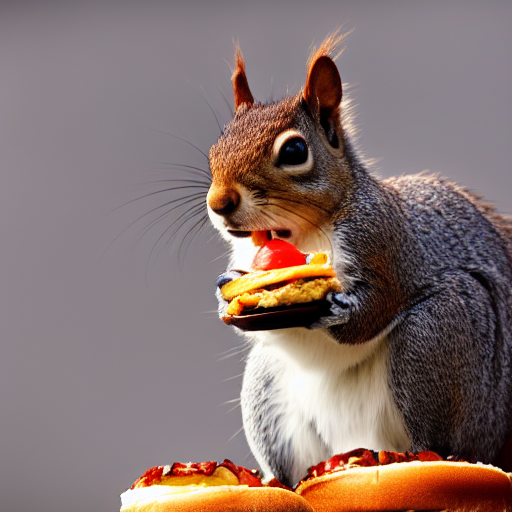

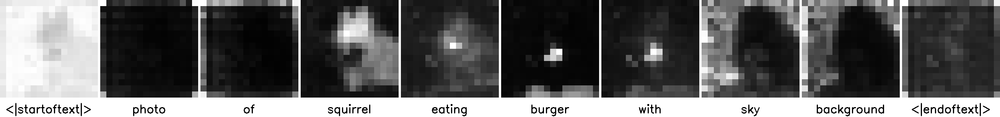

In [10]:
prompts = ["Photo of squirrel eating burger with sky background"]
controller = AttentionStore()
image, x_t = run_and_display(prompts, controller, latent=None, run_baseline=False, seed=seed)
show_cross_attention(controller, res=16, from_where=("up", "down"), last=False)

  0%|          | 0/20 [00:00<?, ?it/s]

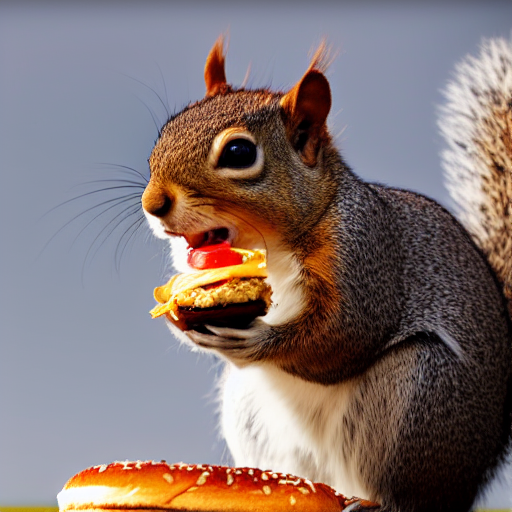

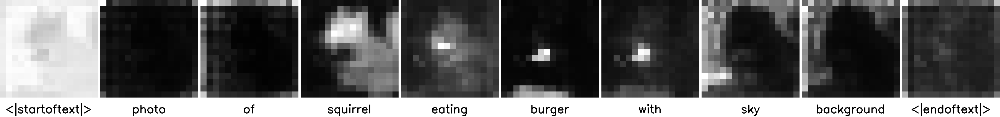

In [44]:
prompts = ["Photo of squirrel eating burger with sky background"]

x_t_modified = x_t.detach().clone().cpu()
if roll_noise:
	x_t_modified = torch.from_numpy(np.roll(x_t_modified, int(-64/roll_frac), axis=3)).cuda()
if roll_attention:
	controller = AttentionPermute(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=1.0, self_replace_steps=1.0)
else:
	controller = AttentionStore()
_ = run_and_display(prompts, controller, latent=x_t_modified, control=None, run_baseline=False)
show_cross_attention(controller, res=16, from_where=("up", "down"), last=False)

  0%|          | 0/20 [00:00<?, ?it/s]

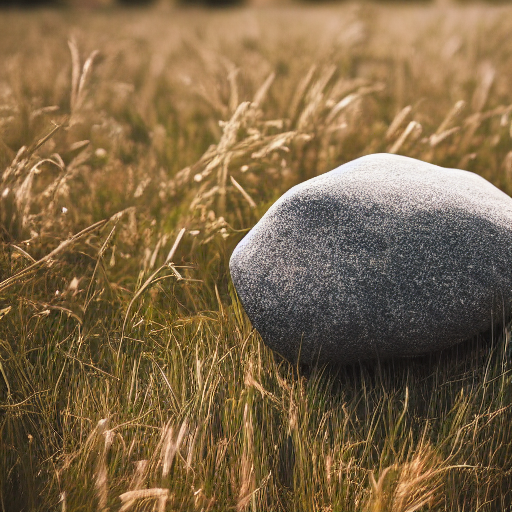

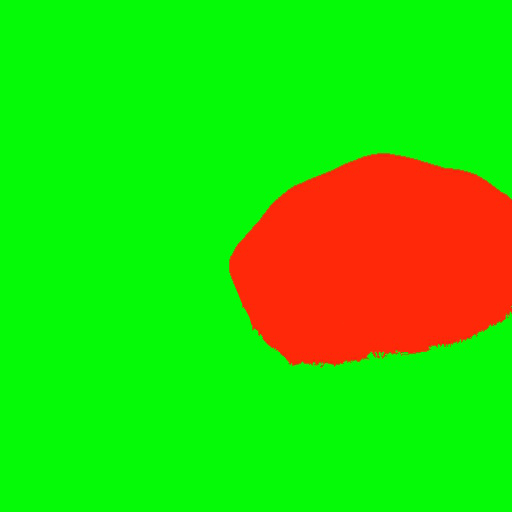

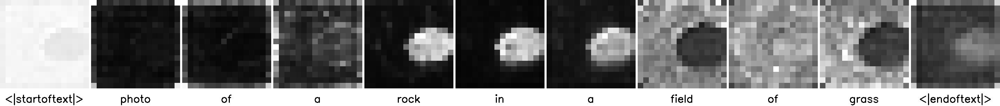

In [17]:
prompts = ["Photo of a rock in a field of grass"]
control_image = Image.open("control/control_image_seed_1.jpg")
controller = AttentionStore()
image, x_t = run_and_display(prompts, controller, latent=None, control=control_image, run_baseline=False, seed=seed)
display(control_image)
show_cross_attention(controller, res=16, from_where=("up", "down"), last=False)

  0%|          | 0/20 [00:00<?, ?it/s]

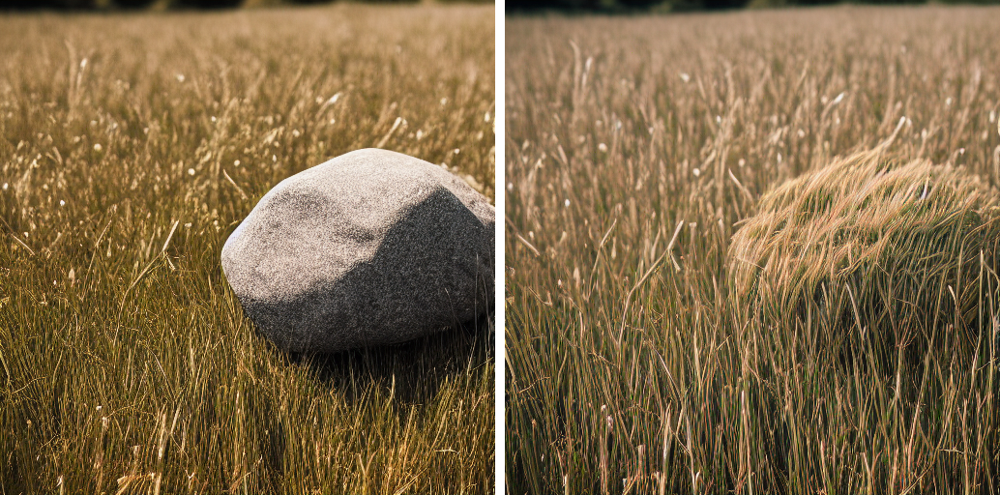

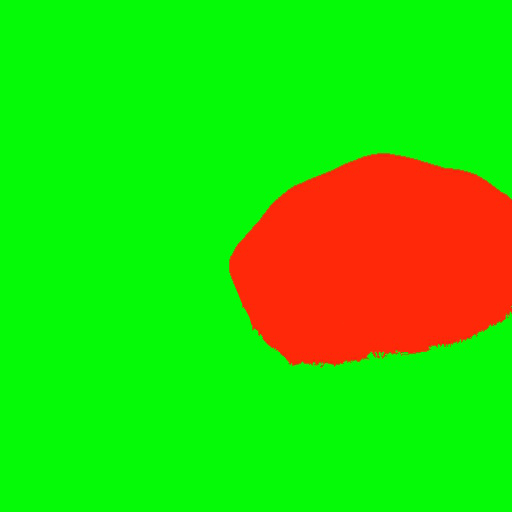

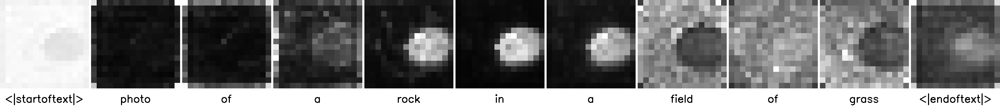

In [55]:
prompts = ["Photo of a rock in a field of grass", "Photo of a grass in a field of grass"]
control_image = Image.open("control/control_image_seed_1.jpg")

controller = AttentionReplace(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps={"default_": .0},
                             self_replace_steps=1.)
image, x_t = run_and_display(prompts, controller, latent=None, control=None, run_baseline=False, seed=seed)
display(control_image)
show_cross_attention(controller, res=16, from_where=("up", "down"), last=False)

## Image Experiments

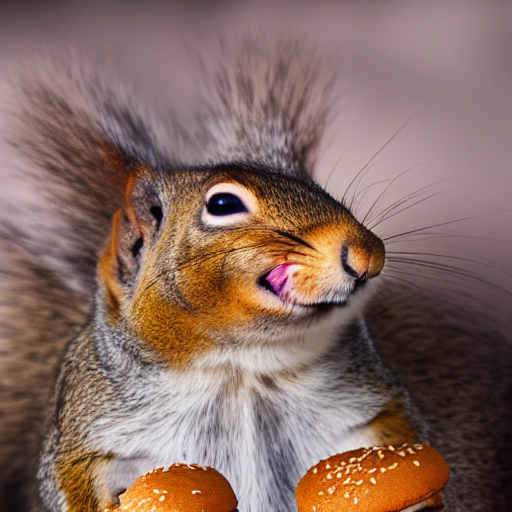

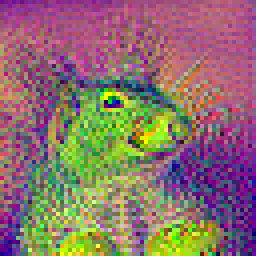

None

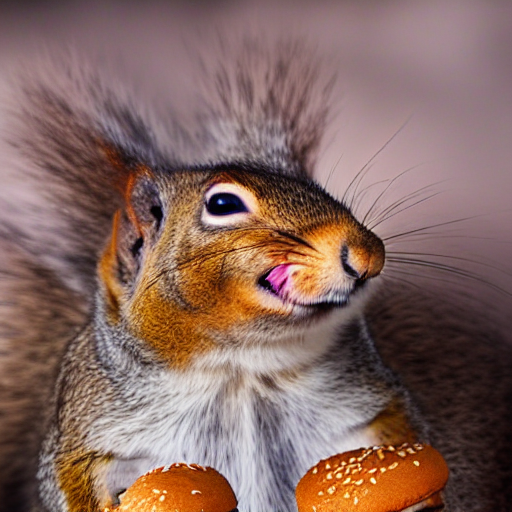

In [125]:
torch.cuda.empty_cache()
img = Image.open("control/selfi.png")
display(img)
latent = ptp_utils.image2latent(ldm_stable.vae, np.array(img))
display(view_noise(latent))
ptp_utils.view_images((ptp_utils.latent2image(ldm_stable.vae, latent)))

  0%|          | 0/20 [00:00<?, ?it/s]

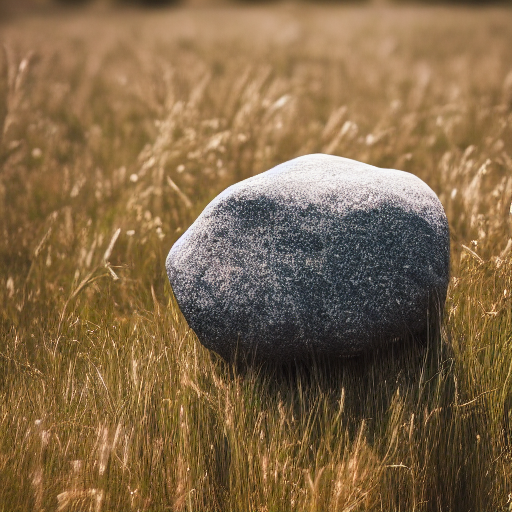

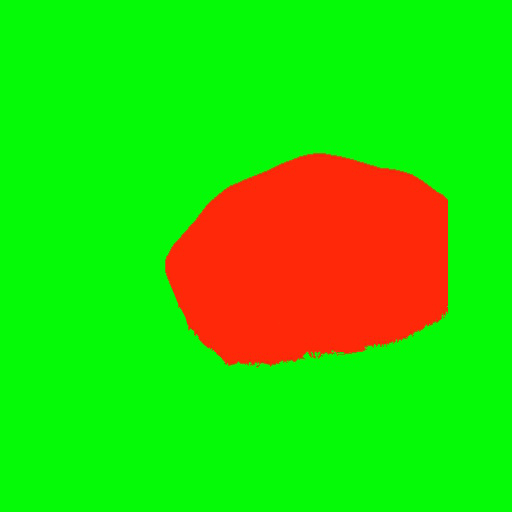

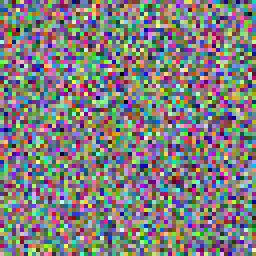

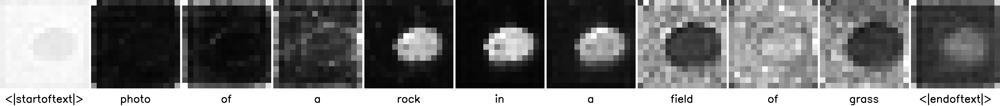

In [45]:
prompts = ["Photo of a rock in a field of grass"]
control_image = Image.open("control/control_image_seed_1.jpg")
generator=torch.Generator().manual_seed(seed)
x_t_modified = x_t.detach().clone().cpu()
if roll_noise:
	x_t_modified = torch.from_numpy(np.roll(x_t_modified, int(-64/roll_frac), axis=3)).cuda()
if roll_attention:
	controller = AttentionPermute(prompts, NUM_DIFFUSION_STEPS, cross_replace_steps=1.0, self_replace_steps=1.0)
else:
	controller = AttentionStore()
if roll_control:
	modified_control_image = np.array(control_image)
	modified_control_image = np.roll(modified_control_image, int(-512/roll_frac), axis=1)
	modified_control_image = Image.fromarray(modified_control_image)
images, latent, _ = ptp_utils.text2image_ldm_stable(ldm_stable, prompts, controller, latent=x_t_modified, control=modified_control_image, num_inference_steps=NUM_DIFFUSION_STEPS, guidance_scale=GUIDANCE_SCALE, generator=generator, low_resource=LOW_RESOURCE)
ptp_utils.view_images(images)
display(modified_control_image)
view_noise(x_t_modified)
show_cross_attention(controller, res=16, from_where=("up", "down"), last=False)

  0%|          | 0/20 [00:00<?, ?it/s]

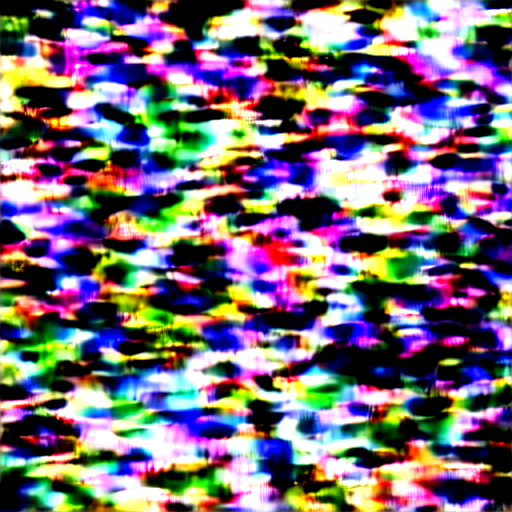

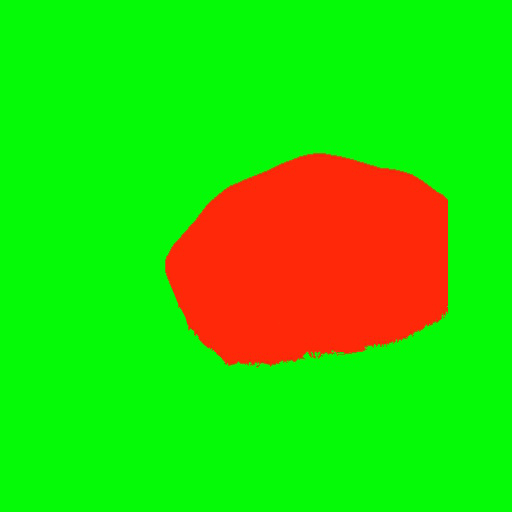

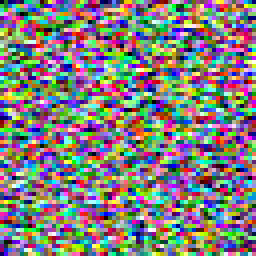

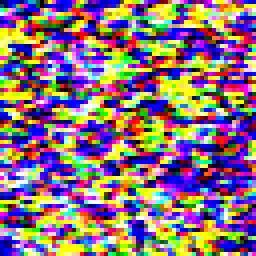

In [32]:
prompts = ["Photo of a rock in a field of grass"]
control_image = Image.open("control/control_image_seed_1.jpg")
generator=torch.Generator().manual_seed(seed)
x_t_modified = x_t.detach().clone().cpu()
# x_t_modified = (0.95*x_t_modified + 0.05*torch.from_numpy(np.roll(x_t_modified, -1, axis=3)))*1.05
# x_t_modified = (0.9*x_t_modified + 0.1*torch.from_numpy(np.roll(x_t_modified, -1, axis=3)))*1.1
x_t_modified = (0.5*x_t_modified + 0.5*torch.from_numpy(np.roll(x_t_modified, -1, axis=3)))#*1.5
# x_t_modified = (0.3*x_t_modified + 0.7*torch.from_numpy(np.roll(x_t_modified, -1, axis=3)))*1.5
#calculate ratio in variance between original and modified to normalise modified
ratio = torch.var(x_t_modified) / torch.var(x_t)
x_t_modified = x_t_modified / ratio
controller = AttentionStore()
if roll_control:
	modified_control_image = np.array(control_image)
	modified_control_image = np.roll(modified_control_image, int(-512/roll_frac), axis=1)
	modified_control_image = Image.fromarray(modified_control_image)
images, latent, final_latent = ptp_utils.text2image_ldm_stable(ldm_stable, prompts, controller, latent=x_t_modified, control=modified_control_image, num_inference_steps=NUM_DIFFUSION_STEPS, guidance_scale=GUIDANCE_SCALE, generator=generator, low_resource=LOW_RESOURCE)
ptp_utils.view_images(images)
display(modified_control_image)
view_noise(x_t_modified)
view_noise(final_latent)

mean -0.0074006803
std 1.0027658


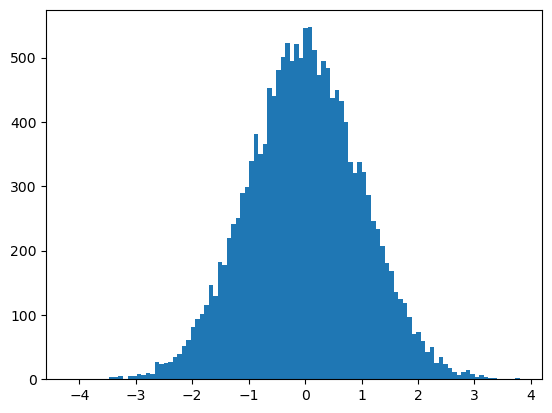

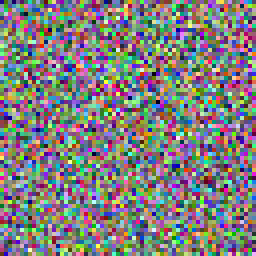

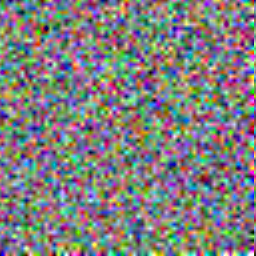

mean -0.005420602
std 0.71285903


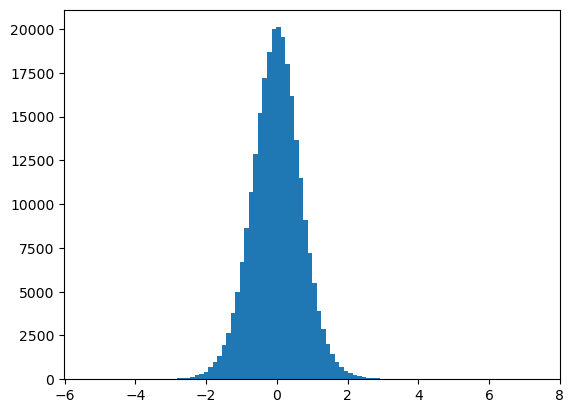

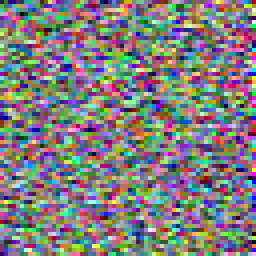

mean -0.00948102
std 1.0026088


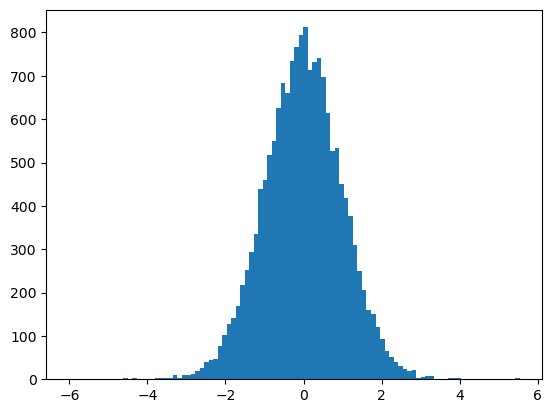

In [63]:
# prompts = ["Photo of a rock in a field of grass"]
# controller = AttentionStore()
# image, x_t = run_and_display(prompts, controller, latent=None, control=control_image, run_baseline=False, seed=seed)
show_histogram(x_t)
view_noise(x_t)
x_t_modified = x_t.detach().clone().cpu().numpy()[0]
#interpolate using scipy regular grid interpolator
interpolators = [interpolate.RegularGridInterpolator((np.arange(0,256,4), np.arange(0,256,4)), x_t_modified[i, :, :], bounds_error=False, fill_value=None) for i in range(4)]
X, Y = np.meshgrid(np.arange(256), np.arange(256), indexing='ij')
x_t_modified = np.array([interpolators[i]((X, Y)) for i in range(4)])
x_t_rolled = np.roll(x_t_modified, -2, axis=2)
x_t_large = torch.from_numpy(x_t_rolled).unsqueeze(0).float().cuda()
view_noise(x_t_large)
show_histogram(x_t_large)
x_t_modified = x_t_rolled[:, ::4, ::4] #sample every 4th pixel
x_t_modified = torch.from_numpy(x_t_modified * 1.363).unsqueeze(0).float().cuda()
view_noise(x_t_modified)
show_histogram(x_t_modified)

## VAE Experiments

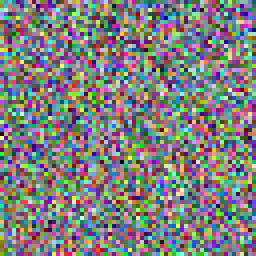

mean -0.0077669825
std 1.0000404


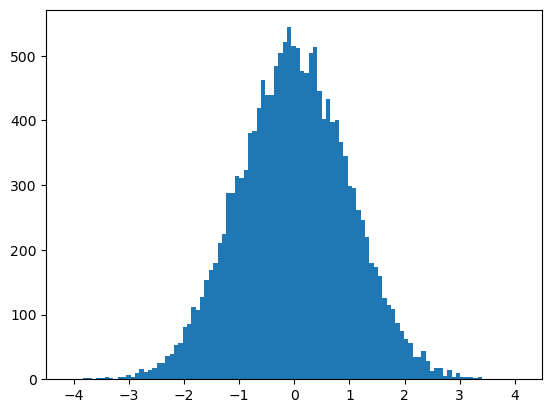

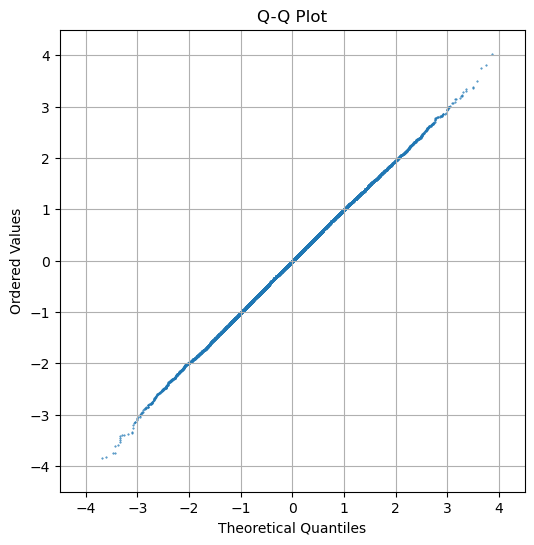

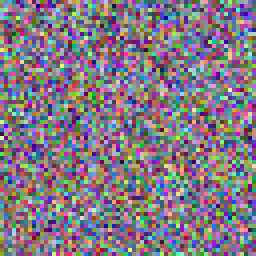

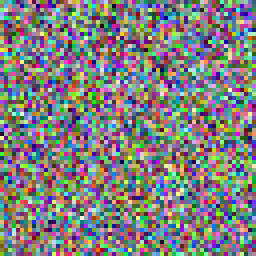

mean 8.190039e-05
std 0.99000865


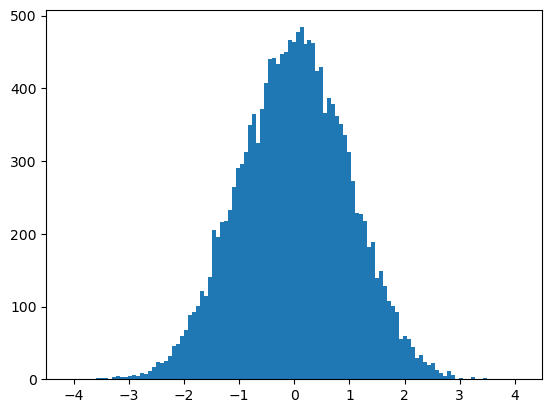

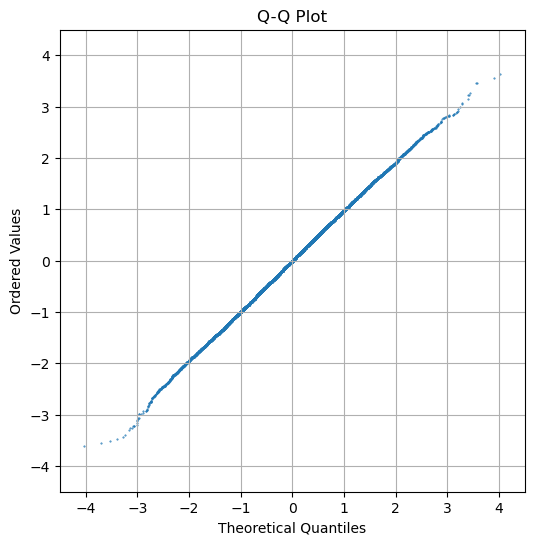

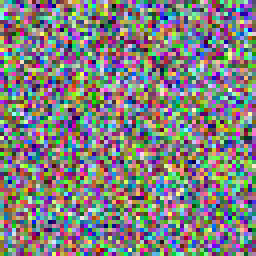

mean 0.00010753574
std 1.0237811


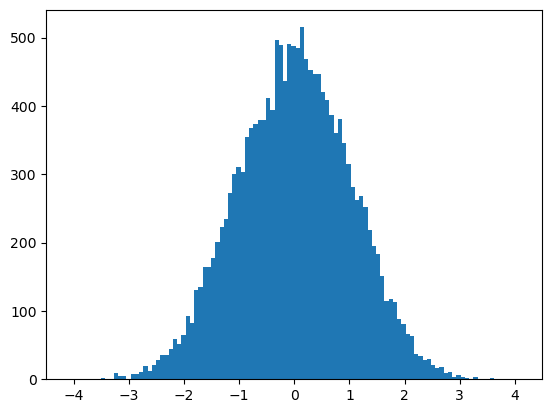

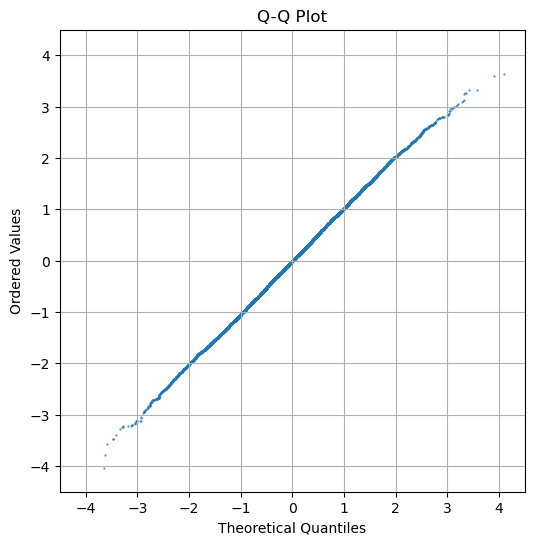

In [17]:
torch.cuda.empty_cache()
prompts = ["Photo of a rock in a field of grass"]
x_t = create_latent(prompts, seed=10)
view_noise(x_t)
# view_noise(torch.diff(x_t, axis=2))
# show_histogram(np.diff(x_t.cpu(), axis=2))
# DFT_2D(x_t)
show_histogram(x_t)
q_q_plot(x_t)
# ptp_utils.view_images(ptp_utils.latent2image(ldm_stable.vae, x_t.cuda()))
x_t = 1/0.18215 * x_t
with torch.no_grad():
	img = ldm_stable.vae.decode(x_t)['sample']
	x_t_2 = ldm_stable.vae.encode(img)['latent_dist'].mean.detach().cpu()
# x_t_2 = (np.power(np.abs(x_t_2), 1.1) * np.sign(x_t_2)) * 0.9
x_t_2 = x_t_2 * 0.18215
view_noise(x_t_2)
# centre mean of all 4 channels individually
x_t_2 = x_t_2 - x_t_2.mean(axis=(2,3), keepdims=True)
#sinh kurtosis transformation
x_t_2 = np.sinh(np.arcsinh(x_t_2) * 0.97) * 1.26
view_noise(x_t_2)
# view_noise(torch.diff(x_t_2, axis=2))
# show_histogram(np.diff(x_t_2.cpu(), axis=2))
# DFT_2D(x_t_2)
show_histogram(x_t_2)
q_q_plot(x_t_2)
# img2 = ptp_utils.latent2image(ldm_stable.vae, x_t_2.cuda())
# ptp_utils.view_images(img2)
with torch.no_grad():
	x_t_2 = 1/0.18215 * x_t_2
	img3 = ldm_stable.vae.decode(x_t_2.cuda())['sample']
	img3_rolled = np.roll(np.array(img3.cpu()), -1, axis=3)
	x_t_3 = ldm_stable.vae.encode(torch.from_numpy(img3_rolled).cuda())['latent_dist'].mean.detach().cpu()
x_t_3 = x_t_3 * 0.18215
# view_noise(x_t_3)
# show_histogram(x_t_3)
x_t_3 = x_t_3 - x_t_3.mean(axis=(2,3), keepdims=True)
#sinh kurtosis transformation
x_t_3 = np.sinh(np.arcsinh(x_t_3) * 0.97) * 1.26
view_noise(x_t_3)
show_histogram(x_t_3)
q_q_plot(x_t_3)

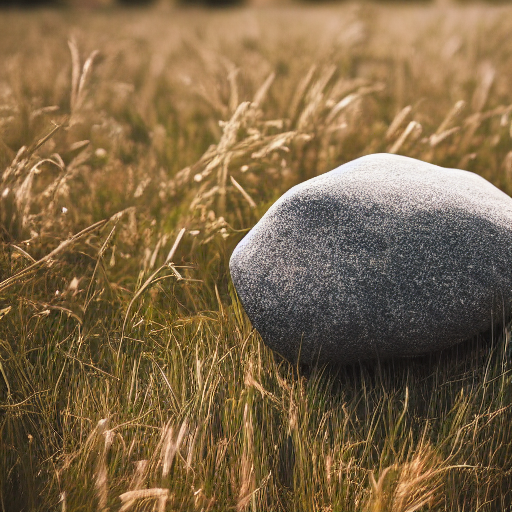

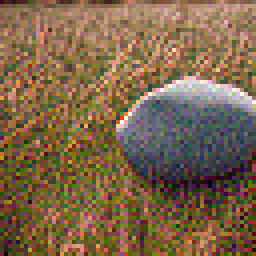

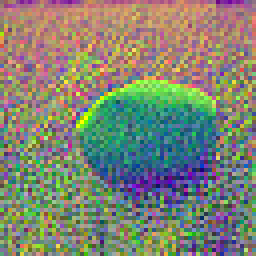

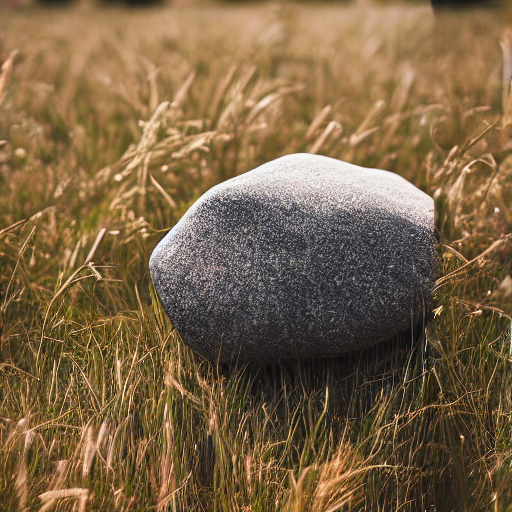

In [20]:
input_img = Image.open("control/rock_img.png")
display(input_img)
latent = ptp_utils.image2latent(ldm_stable.vae, np.array(input_img))
display(latents_to_rgb(latent))
modified_latent = latent.clone().detach().cpu()
modified_latent = torch.from_numpy(np.roll(modified_latent, -10, axis=3)).cuda()
view_noise(modified_latent)
modified_img = ptp_utils.latent2image(ldm_stable.vae, modified_latent)
ptp_utils.view_images(modified_img)

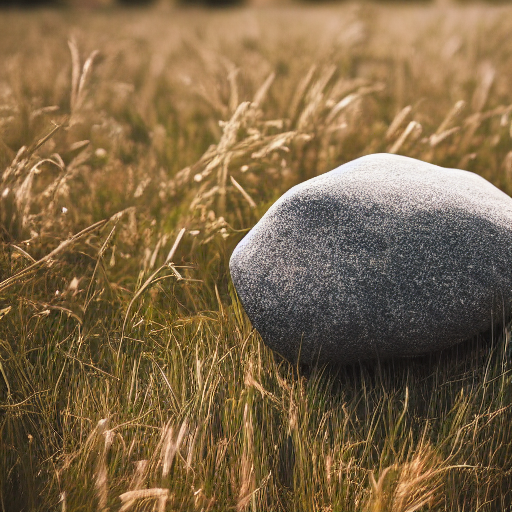

mean 0.038505968
std 0.7254378


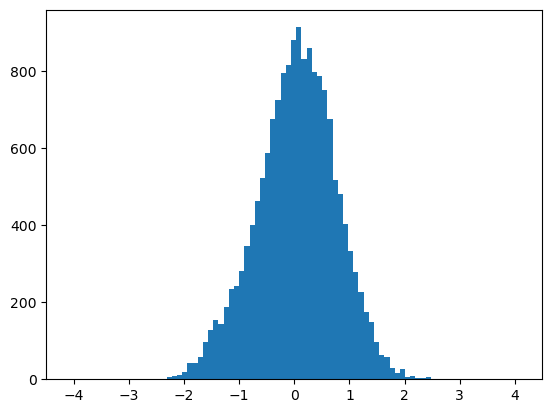

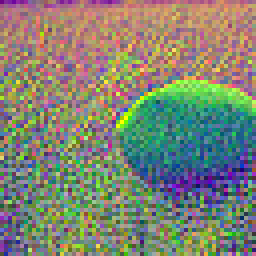

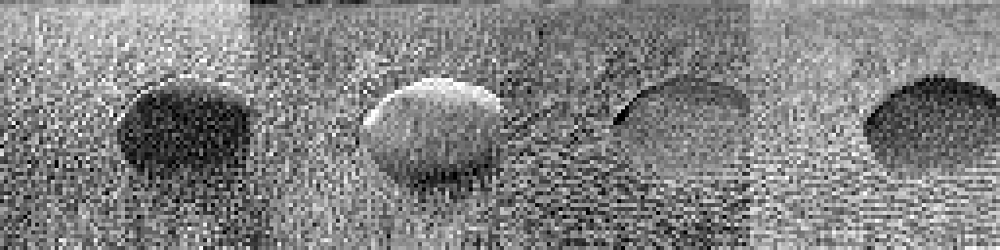

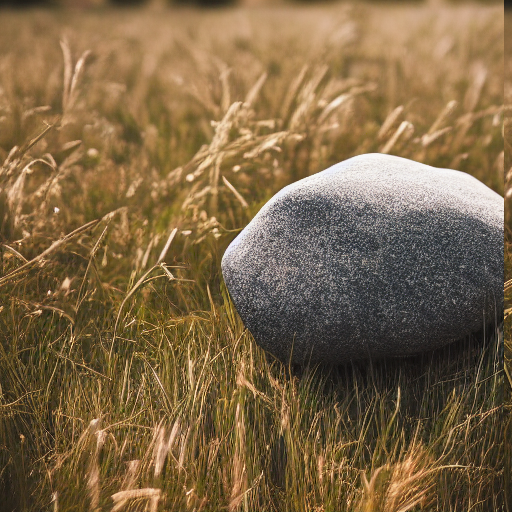

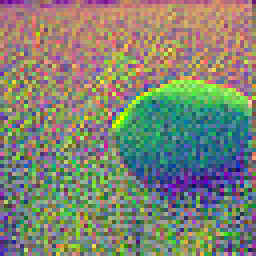

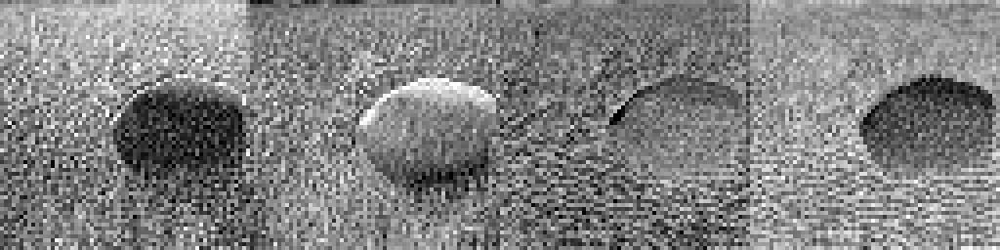

torch.Size([1, 4, 64, 64])


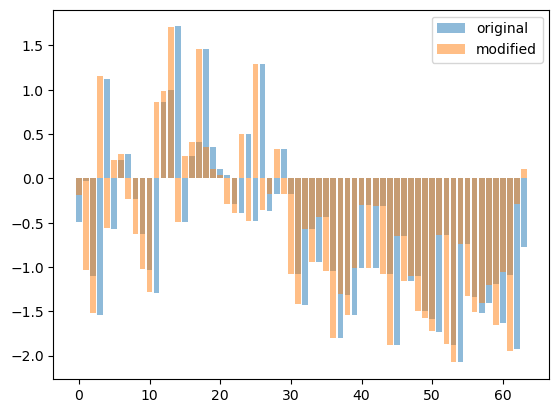

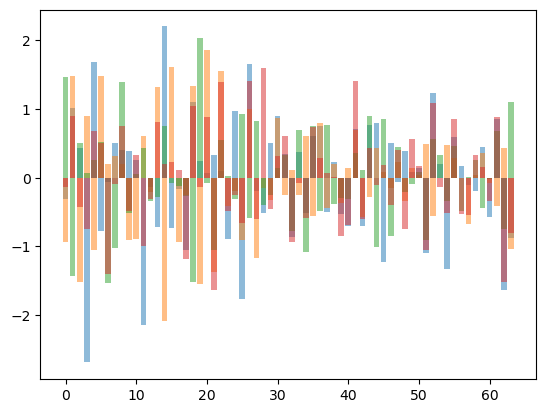

In [77]:
input_img = np.array(Image.open("control/rock_img.png"))
ptp_utils.view_images(input_img)
latent = ptp_utils.image2latent(ldm_stable.vae, input_img)
show_histogram(latent)
view_noise(latent)
view_noise_channels(latent)
modified_img = np.roll(input_img, -8, axis=1)
ptp_utils.view_images(modified_img)
modified_latent = ptp_utils.image2latent(ldm_stable.vae, modified_img)
view_noise(modified_latent)
view_noise_channels(modified_latent)
print(latent.shape)
row_latent = latent[0, :, 32, :].cpu()
row_modified = modified_latent[0, :, 32, :].cpu()
plt.bar(range(64), row_latent[0], alpha=0.5)
plt.bar(range(64), row_modified[0], alpha=0.5)
plt.legend(["original", "modified"])
plt.show()
row_difference = row_latent - row_modified
#bar plot of difference for each channel
plt.bar(range(64), row_difference[0], alpha=0.5)
plt.bar(range(64), row_difference[1], alpha=0.5)
plt.bar(range(64), row_difference[2], alpha=0.5)
plt.bar(range(64), row_difference[3], alpha=0.5)
plt.show()

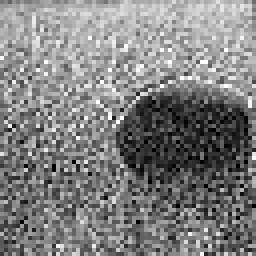

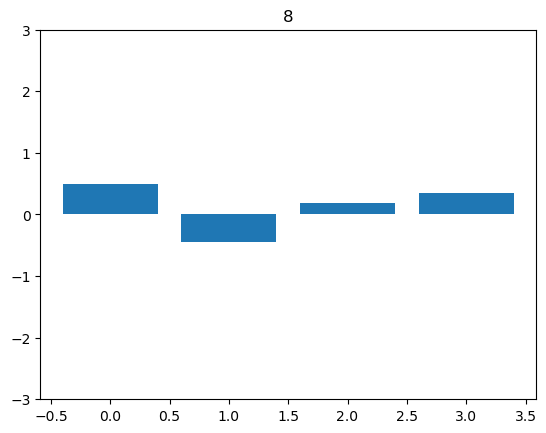

In [14]:
input_img = np.array(Image.open("control/rock_img.png"))
gif_images = []
coordx, coordy = 22, 22
for i in range(9):
	modified_img = np.roll(input_img, -i, axis=1)
	latent = ptp_utils.image2latent(ldm_stable.vae, modified_img)
	clear_output(wait=True)
	rgb_latent = return_noise(latent, channel=0)
	ptp_utils.view_images(np.array(rgb_latent))
	# gif_images.append(rgb_latent)
	point_values = latent[0, :, coordx, coordy].cpu().numpy()
	fig = plt.figure()
	plt.ylim(-3, 3)
	plt.bar(range(4), point_values)
	plt.title(f"{i}")
	plt.show()
	fig.savefig("output/tmpplot.png")
	gif_images.append(Image.open("output/tmpplot.png").convert('RGB'))
id = np.random.randint(0,10000)
gif_images[0].save(f'output/latent_roll{id}.gif', save_all=True, append_images=gif_images[1:], duration=150, loop=0)

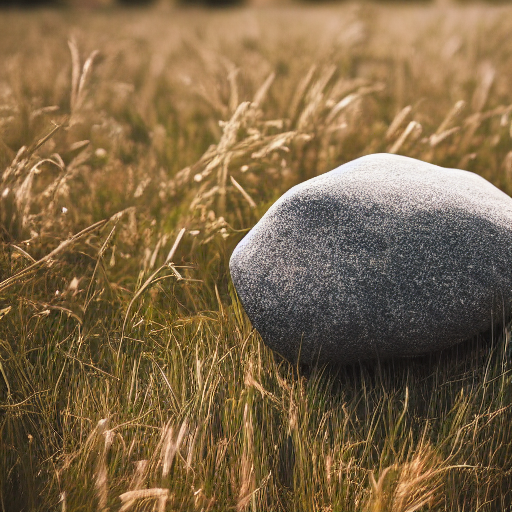

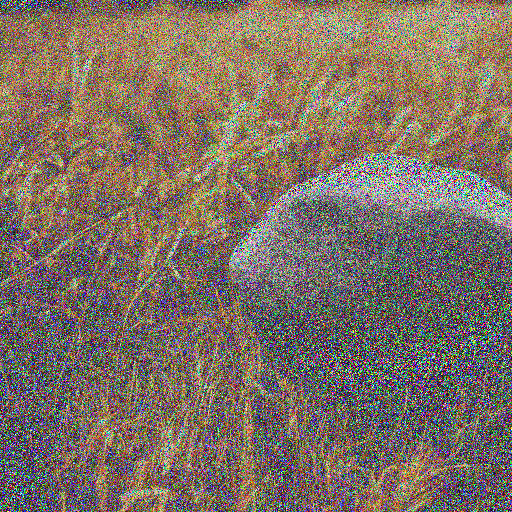

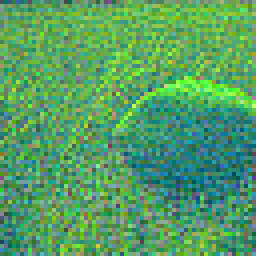

In [18]:
img = np.array(Image.open("control/rock_img.png"))
ptp_utils.view_images(img)
img = img + 50*np.random.randn(512, 512, 3)
ptp_utils.view_images(img)
latent = ptp_utils.image2latent(ldm_stable.vae, img)
view_noise(latent)

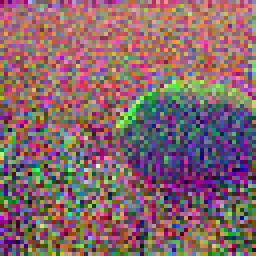

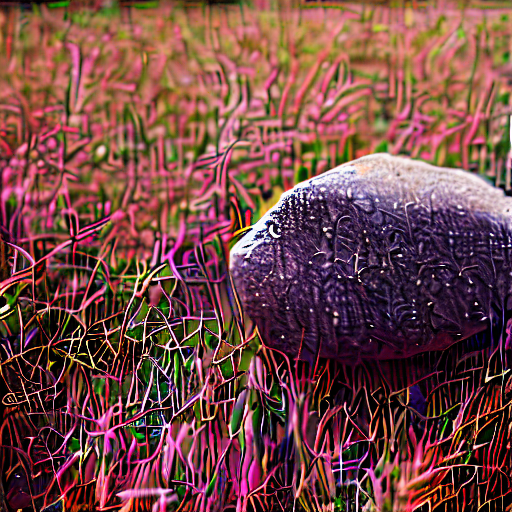

In [51]:
curr_img = Image.open("control/rock_img.png")
for i in range(10):
	curr_latent = ptp_utils.image2latent(ldm_stable.vae, np.array(curr_img))
	curr_img = ptp_utils.latent2image(ldm_stable.vae, curr_latent)
	clear_output(wait=True)
	view_noise(curr_latent)
	ptp_utils.view_images(curr_img)
	curr_img = np.squeeze(curr_img)

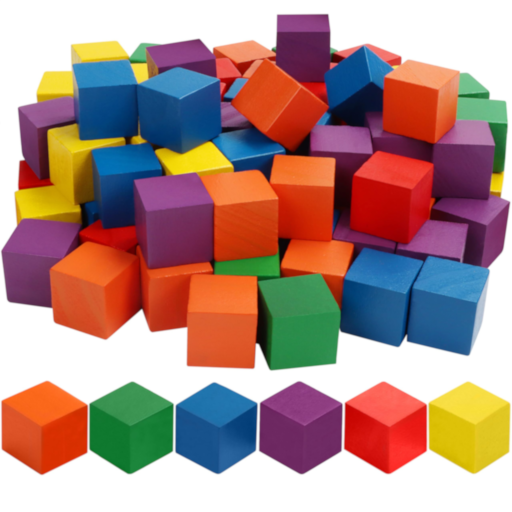

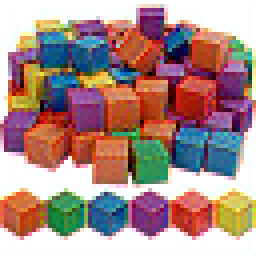

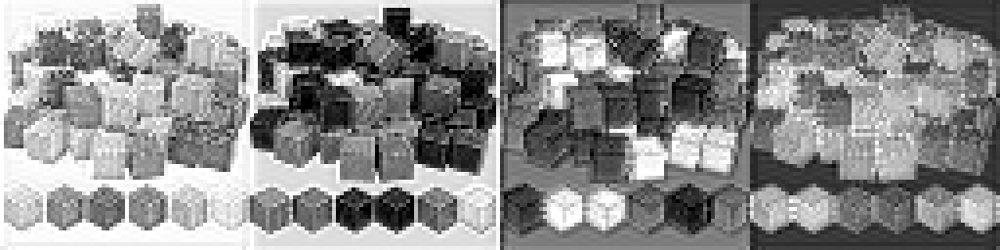

In [18]:
colours = Image.open("control/colours.png")
display(colours)
latent = ptp_utils.image2latent(ldm_stable.vae, np.array(colours))
display(latents_to_rgb(latent))
view_noise_channels(latent)

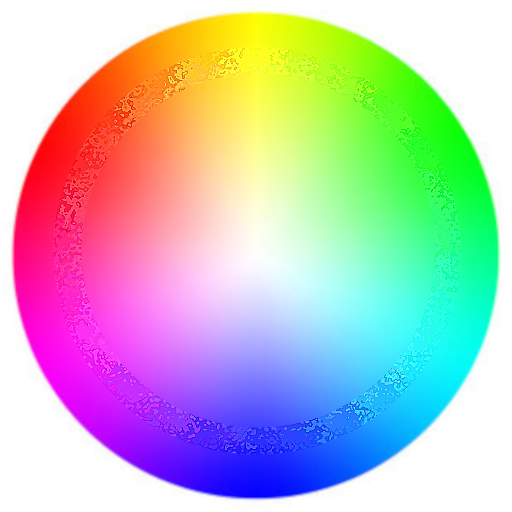

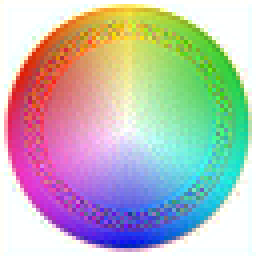

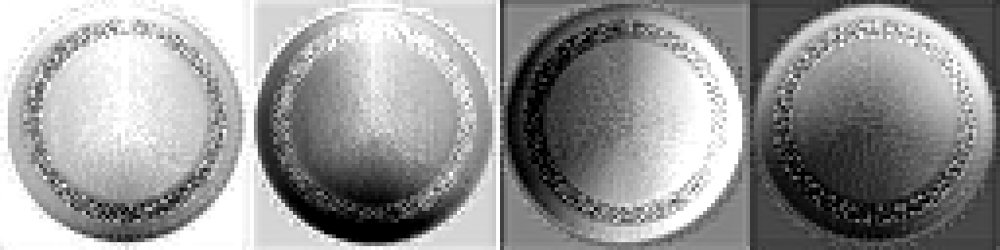

In [19]:
colours = Image.open("control/colour wheel.png")
latent = ptp_utils.image2latent(ldm_stable.vae, np.array(colours))
display(colours)
display(latents_to_rgb(latent))
view_noise_channels(latent)

## Prompt-to-Video

In [ ]:
prompts = ["Photo of a rock in a field of grass"]
control_image = Image.open("control/control_image_seed_1.jpg")
create_animation(ldm_stable, prompts, control_image, None, start=-12, stop=13, noise_anim="pan", control_anim="pan", cond_scale=1.0)

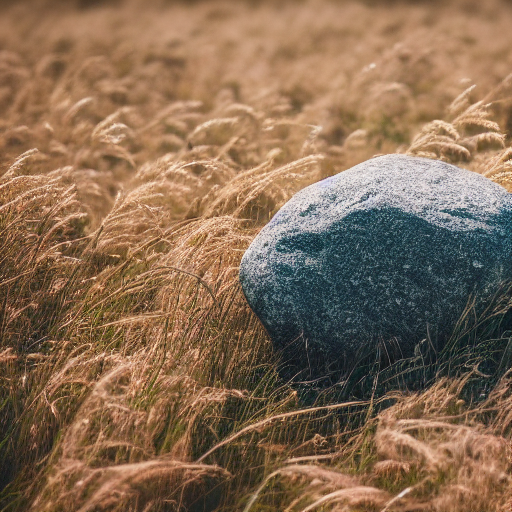

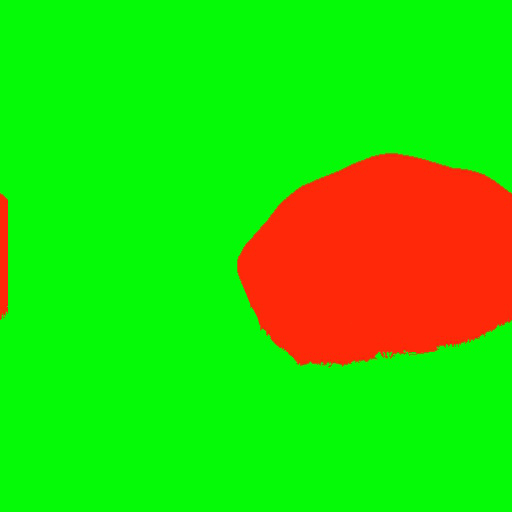

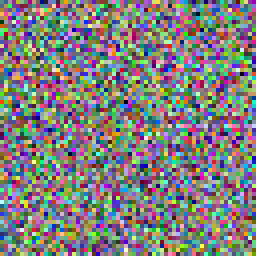

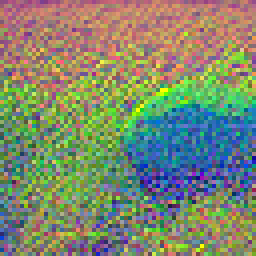

18
saved as output/roll3609.gif


In [19]:
prompts = ["Photo of a rock in a field of grass"]
control_image = Image.open("control/control_image_seed_1.jpg").convert('RGB')
# control_image = Image.open("control/control_image_grass_only_distraction.jpg").convert('RGB')
noise_mask = Image.open("control/rock_noise_mask.png").convert('L')
# create_animation(ldm_stable, prompts, control_image, None, noise_mask, start=0, stop=19, switch_percent=15, annealing=0, noise_anim="parallax", control_anim="perspective", cond_scale=1.0)
# create_animation(ldm_stable, prompts, control_image, None, None, start=0, stop=32, switch_percent=70, straight_ahead=False, noise_anim="flow", control_anim="pan", cond_scale=1.0)
# create_animation(ldm_stable, prompts, control_image, None, noise_mask, start=0, stop=19, annealing=2, noise_anim="parallax", control_anim="perspective", cond_scale=1.0)
# create_animation(ldm_stable, prompts, control_image, None, noise_mask, start=0, stop=19, switch_percent=50, noise_anim="parallax", control_anim="perspective", cond_scale=1.0)
# create_animation(ldm_stable, prompts, control_image, None, None, start=0, stop=5, switch_percent=0, noise_anim="pan", control_anim="perspective", cond_scale=0.0, flip=True)
# create_animation(ldm_stable, prompts, control_image, None, noise_mask, start=0, stop=19, switch_percent=0, noise_anim="parallax", control_anim="perspective", cond_scale=1.0, flip=True)
create_animation(ldm_stable, prompts, control_image, None, noise_mask, start=0, stop=19, switch_percent=25, noise_anim="parallax", control_anim="perspective", cond_scale=1.0)

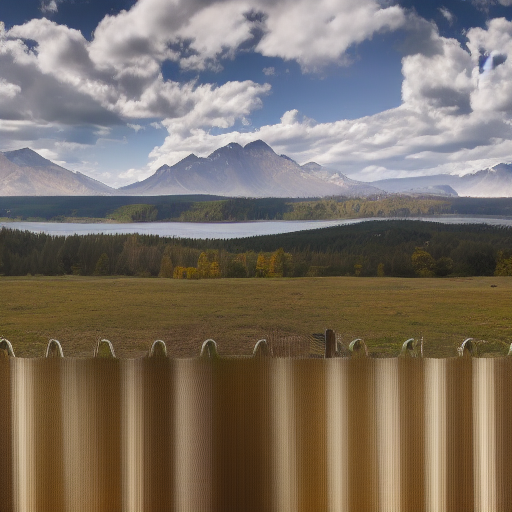

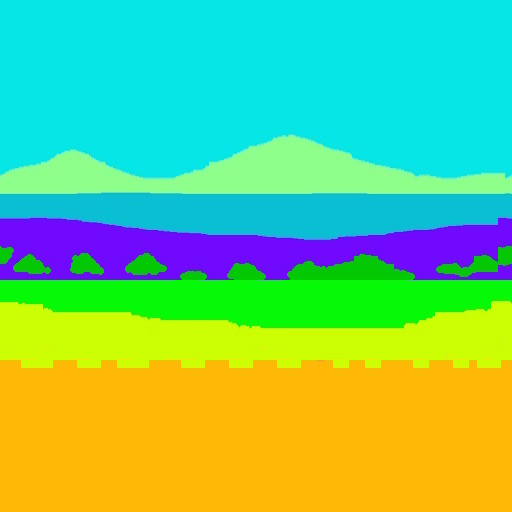

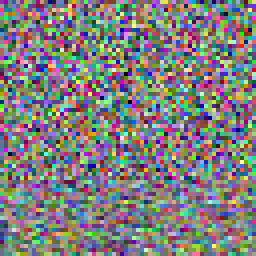

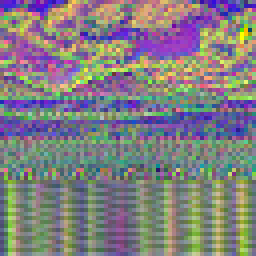

7
saved as roll6288.gif


In [24]:
prompts = ["Vista of mountains and lake and trees, with wooden fence in foreground"]
control_image = Image.open("control/control_image_vista.jpg").convert('RGB')
create_animation(ldm_stable, prompts, control_image, None, start=0, stop=8, switch_percent=70, annealing=0, noise_anim="parallax2", control_anim="perspective2", cond_scale=1.0)

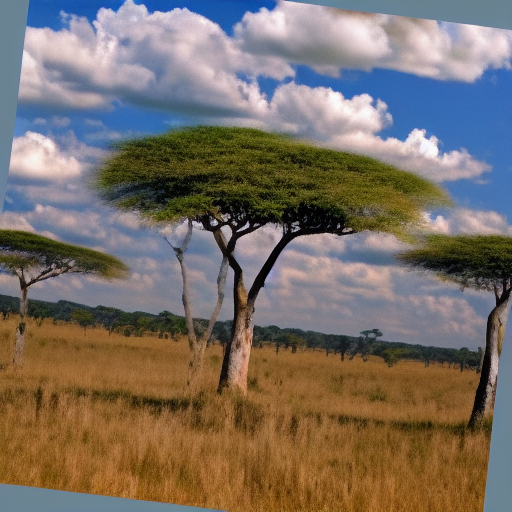

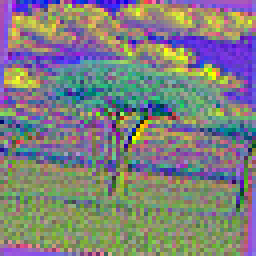

7
saved as output/roll1853.gif


In [33]:
prompts = ["Acacia trees in the savannah, long grass, sky with small clouds"]
control_image = Image.open("control/sway_control.png").convert('RGB')
flow = Image.open("control/sway_flow.png").convert('RGB')
# create_animation(ldm_stable, prompts, control_image, flow, None, wrap=False, start=0, stop=19, switch_percent=75, annealing=0, noise_anim="flow", control_anim="pan", cond_scale=1.0, seed=1)
# create_animation(ldm_stable, prompts, control_image, None, None, wrap=False, start=0, stop=8, switch_percent=75, annealing=0, noise_anim="zoom", control_anim="pan", cond_scale=1.0, seed=1)
create_animation(ldm_stable, prompts, control_image, None, None, wrap=False, start=0, stop=8, switch_percent=50, annealing=0, noise_anim="rotate", control_anim="pan", cond_scale=1.0, seed=1)

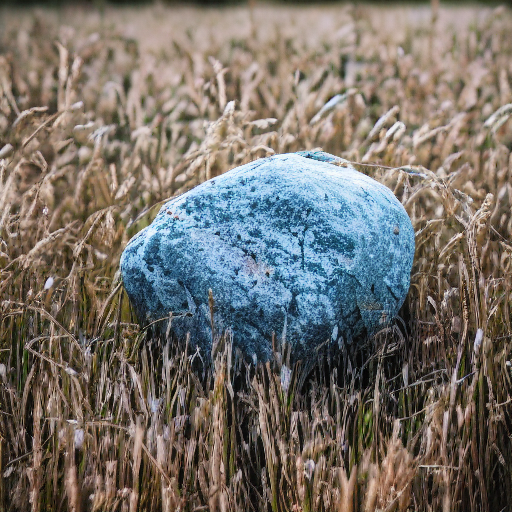

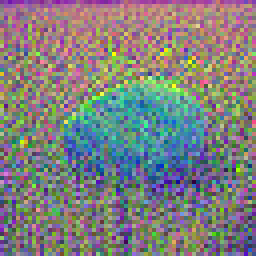

4
saved as output/roll9768.gif


In [37]:
prompts = ["A photo of a rock in a field of grass"]
control_image = Image.open("control/control_image_rock_2.png").convert('RGB')
flow = Image.open("control/rock_flow.png").convert('RGB')
create_animation(ldm_stable, prompts, control_image, flow, None, wrap=True, start=0, stop=5, switch_percent=60, annealing=0, noise_anim="flow", control_anim="pan", cond_scale=1.0, seed=1)

## Image-to-Video

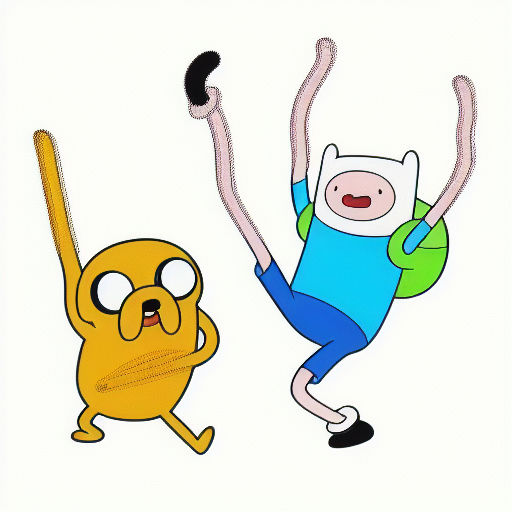

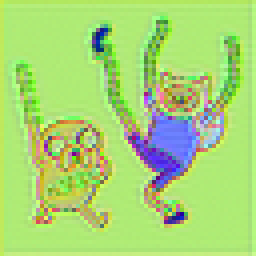

15


KeyboardInterrupt: 

In [15]:
prompt = "Adventure time Finn and Jake"
image = Image.open("control/adventure_time.png")
flow = Image.open("control/adventure_flow.png").convert('RGB')
create_animation(ldm_stable, prompt, flow=flow, image=image, stop=16, switch_percent=70, noise_anim="flow", seed=1)

## Seamless Upscaling

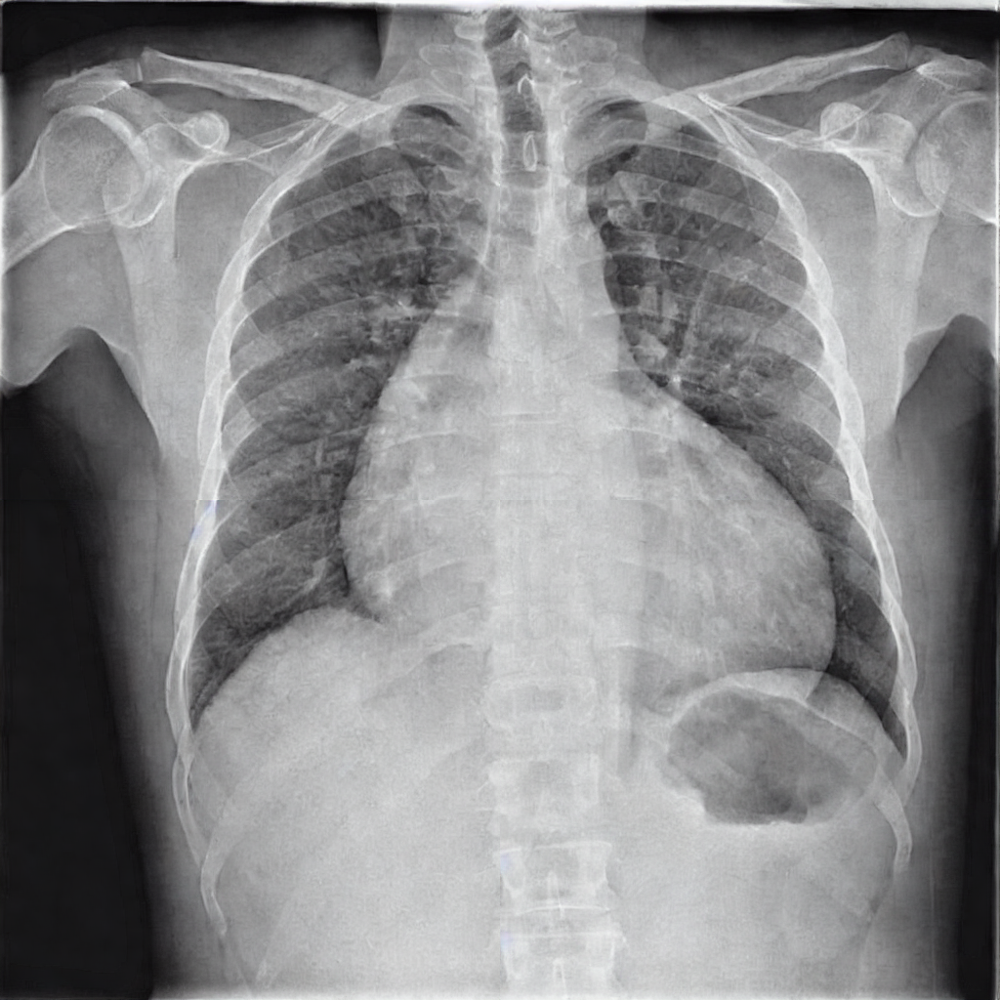

In [30]:
image = Image.open("control/xray_input_2.png").convert('RGB')
upscale_and_stitch(image, mult=2)

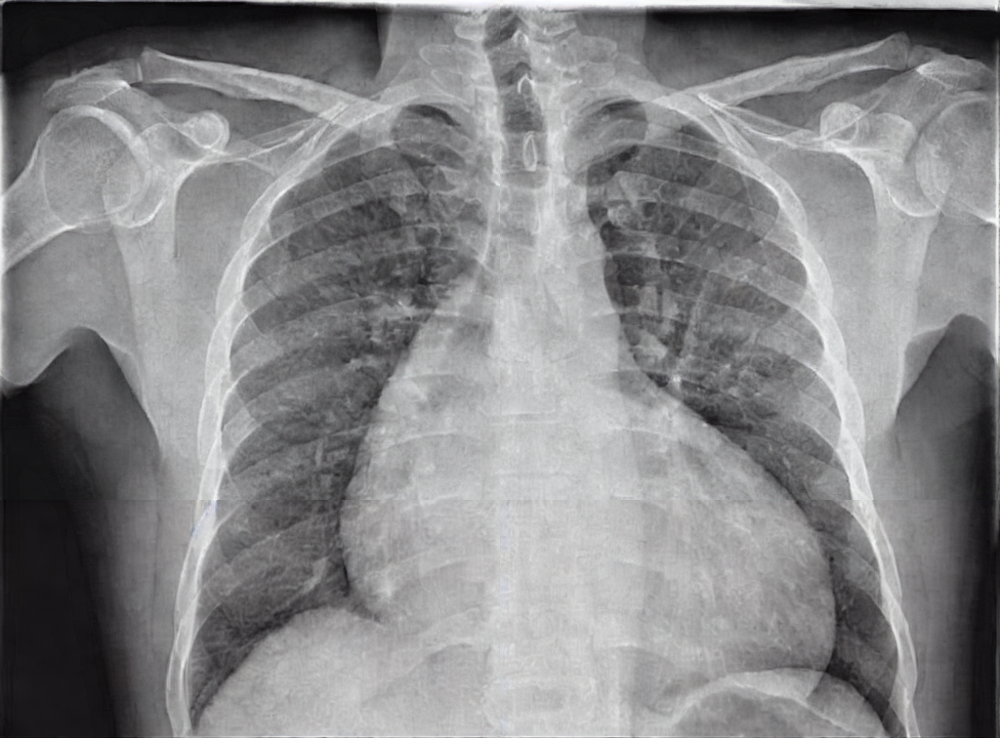

In [31]:
image = Image.open("control/xray_input_3.png").convert('RGB')
# upscale_and_stitch(image, mult=3)
upscale_and_stitch(image, mult=2, seamless=True)

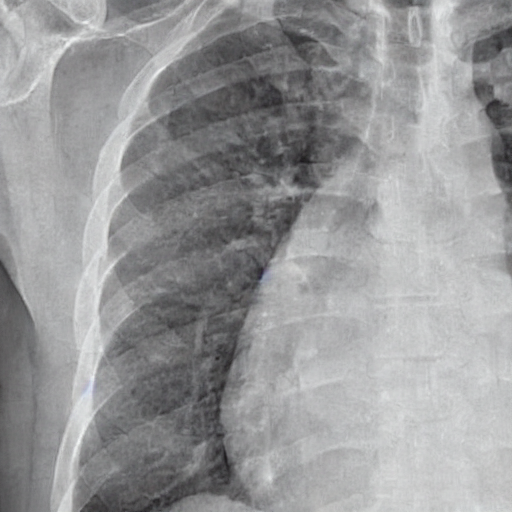

In [33]:
image = Image.open("control/xray_input_3.png").convert('RGB')
# magnifying_glass(image, coords=(64, 64), mult=2, seed=1, seamless=True)
magnifying_glass(image, coords=(64, 64), mult=2, seed=1, seamless=False)